In [1]:
import warnings
warnings.filterwarnings("ignore")


In [2]:
pip install patchify

Note: you may need to restart the kernel to use updated packages.


In [3]:
import matplotlib.pyplot as plt
import numpy as np 
import pandas as pd 
import glob
import torch
from torch.utils.data import DataLoader, Dataset
import torchvision.transforms as trns
import torch.nn as nn
# from torchmetrics import JaccardIndex
from sklearn.model_selection import train_test_split
from PIL import ImageColor
import matplotlib.patches as mpatches
import torchvision
import cv2
from patchify import patchify
from PIL import Image
from keras.utils import to_categorical
# import segmentation_models as sm

In [4]:
class CustomData(Dataset):
    def __init__(self, train=True):
        BGR_classes = {'Water' :[226, 169, 41],
                            'Land' : [132, 41, 246],
                            'Road' : [110, 193, 228],
                            'Building' : [60, 16, 152],
                            'Vegetation' : [254, 221, 58],
                            'Unlabeled' : [155, 155, 155]} 
        self.patch_size = 256
        self.images = []
        self.masks = []
        folders = glob.glob("../data/*")
        # folders.remove("/kaggle/input/semantic-segmentation-of-aerial-imagery/Semantic segmentation dataset/classes.json")
        for f in folders:
            files = glob.glob(f"{f}/*")
            
            self.images.append(glob.glob(f"{files[0]}/*")); self.masks.append(glob.glob(f"{files[1]}/*"))
        self.images= sorted(np.array(self.images).reshape(-1)); self.masks = sorted(np.array(self.masks).reshape(-1))
        X_train, X_test, y_train, y_test = train_test_split(self.images, self.masks, test_size=0.2, shuffle=True)
        self.np_images = []
        self.np_masks = []


        trans = trns.Compose([trns.ToTensor()])
        if train:
            for li, lm in zip(X_train, y_train):
                image = cv2.imread(li, 1)  #Read each image as BGR
                SIZE_X = (image.shape[1]//self.patch_size)*self.patch_size #Nearest size divisible by our patch size
                SIZE_Y = (image.shape[0]//self.patch_size)*self.patch_size #Nearest size divisible by our patch size
                image = Image.fromarray(image)
                image = image.crop((0 ,0, SIZE_X, SIZE_Y))  #Crop from top left corner
                #image = image.resize((SIZE_X, SIZE_Y))  #Try not to resize for semantic segmentation
                image = np.array(image)             
       
                #Extract patches from each image
                print("Now patchifying image:", li)
                patches_img = patchify(image, (self.patch_size, self.patch_size, 3), step=self.patch_size)

                for i in range(patches_img.shape[0]):
                    for j in range(patches_img.shape[1]):
                        
                        single_patch_img = patches_img[i,j,:,:]
                        
                        #Use minmaxscaler instead of just dividing by 255.
                        
                        single_patch_img = trans(single_patch_img[0])
                                  
                        self.np_images.append(single_patch_img)
                        
                mask = cv2.imread(lm)  #Read each image as Grey (or color but remember to map each color to an integer)
                mask = cv2.cvtColor(mask,cv2.COLOR_BGR2RGB)
                SIZE_X = (mask.shape[1]//self.patch_size)*self.patch_size #Nearest size divisible by our patch size
                SIZE_Y = (mask.shape[0]//self.patch_size)*self.patch_size #Nearest size divisible by our patch size
                mask = Image.fromarray(mask)
                mask = mask.crop((0 ,0, SIZE_X, SIZE_Y))  #Crop from top left corner
                #mask = mask.resize((SIZE_X, SIZE_Y))  #Try not to resize for semantic segmentation
                mask = np.array(mask)             
       
                #Extract patches from each image
                print("Now patchifying mask:", lm)
                patches_mask = patchify(mask, (self.patch_size, self.patch_size, 3), step=self.patch_size)
           
                for i in range(patches_mask.shape[0]):
                    for j in range(patches_mask.shape[1]):
                        
                        single_patch_mask = patches_mask[i,j,:,:]
                        label_seg = np.zeros(single_patch_mask[0].shape, dtype=np.uint8)
                        label_seg[np.all(single_patch_mask[0]==BGR_classes['Building'], axis=-1)]=0
                        label_seg[np.all(single_patch_mask[0]==BGR_classes["Land"], axis=-1)]=1
                        label_seg[np.all(single_patch_mask[0]==BGR_classes["Road"], axis=-1)]=2
                        label_seg[np.all(single_patch_mask[0]==BGR_classes["Vegetation"], axis=-1)]=3
                        label_seg[np.all(single_patch_mask[0]==BGR_classes["Water"], axis=-1)]=4
                        label_seg[np.all(single_patch_mask[0]==BGR_classes["Unlabeled"], axis=-1)]=5
                        label_seg = to_categorical(label_seg[:,:,0], num_classes=6)
                        single_patch_mask = trans(label_seg)

                        self.np_masks.append(single_patch_mask) 
                    
                
            
                
        else:
            for li, lm in zip(X_test, y_test):
                image = cv2.imread(li, 1)  #Read each image as BGR
                SIZE_X = (image.shape[1]//self.patch_size)*self.patch_size #Nearest size divisible by our patch size
                SIZE_Y = (image.shape[0]//self.patch_size)*self.patch_size #Nearest size divisible by our patch size
                image = Image.fromarray(image)
                image = image.crop((0 ,0, SIZE_X, SIZE_Y))  #Crop from top left corner
                #image = image.resize((SIZE_X, SIZE_Y))  #Try not to resize for semantic segmentation
                image = np.array(image)             
       
                #Extract patches from each image
                print("Now patchifying image:", li)
                patches_img = patchify(image, (self.patch_size, self.patch_size, 3), step=self.patch_size)

                for i in range(patches_img.shape[0]):
                    for j in range(patches_img.shape[1]):
                        
                        single_patch_img = patches_img[i,j,:,:]
                        
                        
                        
                        single_patch_img = trans(single_patch_img[0])#Use minmaxscaler instead of just dividing by 255.
                        
                        self.np_images.append(single_patch_img)
                        
                mask = cv2.imread(lm)  #Read each image as Grey (or color but remember to map each color to an integer)
                mask = cv2.cvtColor(mask,cv2.COLOR_BGR2RGB)
                SIZE_X = (mask.shape[1]//self.patch_size)*self.patch_size #Nearest size divisible by our patch size
                SIZE_Y = (mask.shape[0]//self.patch_size)*self.patch_size #Nearest size divisible by our patch size
                mask = Image.fromarray(mask)
                mask = mask.crop((0 ,0, SIZE_X, SIZE_Y))  #Crop from top left corner
                #mask = mask.resize((SIZE_X, SIZE_Y))  #Try not to resize for semantic segmentation
                mask = np.array(mask)             
       
                #Extract patches from each image
                print("Now patchifying mask:", lm)
                patches_mask = patchify(mask, (self.patch_size, self.patch_size, 3), step=self.patch_size)

                for i in range(patches_mask.shape[0]):
                    for j in range(patches_mask.shape[1]):
                        
                        single_patch_mask = patches_mask[i,j,:,:]
                        label_seg = np.zeros(single_patch_mask[0].shape, dtype=np.uint8)
                        label_seg[np.all(single_patch_mask[0]==BGR_classes['Building'], axis=-1)]=0
                        label_seg[np.all(single_patch_mask[0]==BGR_classes["Land"], axis=-1)]=1
                        label_seg[np.all(single_patch_mask[0]==BGR_classes["Road"], axis=-1)]=2
                        label_seg[np.all(single_patch_mask[0]==BGR_classes["Vegetation"], axis=-1)]=3
                        label_seg[np.all(single_patch_mask[0]==BGR_classes["Water"], axis=-1)]=4
                        label_seg[np.all(single_patch_mask[0]==BGR_classes["Unlabeled"], axis=-1)]=5
                        label_seg = to_categorical(label_seg[:,:,0], num_classes=6)
                        single_patch_mask = trans(label_seg)
                                                    
                        self.np_masks.append(single_patch_mask)      
        
    def __getitem__(self, index) :
        return self.np_images[index], self.np_masks[index]
    def __len__(self):
        return len(self.np_images)

In [5]:
class CustomData_test(Dataset):
    def __init__(self, images, masks):
        BGR_classes = {'Water' :[226, 169, 41],
                            'Land' : [132, 41, 246],
                            'Road' : [110, 193, 228],
                            'Building' : [60, 16, 152],
                            'Vegetation' : [254, 221, 58],
                            'Unlabeled' : [155, 155, 155]} 
        self.np_images = []
        self.np_masks = []


        trans = trns.Compose([ trns.ToTensor(), trns.Resize((256,256))])
        
        for li, lm in zip(images, masks):
            image = cv2.imread(li, 1)  #Read each image as BGR 
            image = Image.fromarray(image)
            image = trans(image)
                      
            self.np_images.append(image)
                    
            mask = cv2.imread(lm)  #Read each image as Grey (or color but remember to map each color to an integer)
            mask = cv2.cvtColor(mask,cv2.COLOR_BGR2RGB)        
            label_seg = np.zeros(mask.shape, dtype=np.uint8)
            label_seg[np.all(mask==BGR_classes['Building'], axis=-1)]=0
            label_seg[np.all(mask==BGR_classes["Land"], axis=-1)]=1
            label_seg[np.all(mask==BGR_classes["Road"], axis=-1)]=2
            label_seg[np.all(mask==BGR_classes["Vegetation"], axis=-1)]=3
            label_seg[np.all(mask==BGR_classes["Water"], axis=-1)]=4
            label_seg[np.all(mask==BGR_classes["Unlabeled"], axis=-1)]=5
            label_seg = to_categorical(label_seg[:,:,0], num_classes=6)
            
            single_patch_mask = trans(label_seg)

            self.np_masks.append(single_patch_mask) 
                 
        
    def __getitem__(self, index) :
        return self.np_images[index], self.np_masks[index]
    def __len__(self):
        return len(self.np_images)

In [6]:
Train_data = CustomData()
Test_data = CustomData(False)

Now patchifying image: /kaggle/input/semantic-segmentation-of-aerial-imagery/Semantic segmentation dataset/Tile 2/images/image_part_003.jpg
Now patchifying mask: /kaggle/input/semantic-segmentation-of-aerial-imagery/Semantic segmentation dataset/Tile 2/masks/image_part_003.png
Now patchifying image: /kaggle/input/semantic-segmentation-of-aerial-imagery/Semantic segmentation dataset/Tile 5/images/image_part_004.jpg
Now patchifying mask: /kaggle/input/semantic-segmentation-of-aerial-imagery/Semantic segmentation dataset/Tile 5/masks/image_part_004.png
Now patchifying image: /kaggle/input/semantic-segmentation-of-aerial-imagery/Semantic segmentation dataset/Tile 7/images/image_part_008.jpg
Now patchifying mask: /kaggle/input/semantic-segmentation-of-aerial-imagery/Semantic segmentation dataset/Tile 7/masks/image_part_008.png
Now patchifying image: /kaggle/input/semantic-segmentation-of-aerial-imagery/Semantic segmentation dataset/Tile 3/images/image_part_006.jpg
Now patchifying mask: /kag

In [7]:
train_loader = DataLoader(Train_data, 16, True)
test_loader= DataLoader(Test_data, 8, shuffle=True)

In [8]:
x= next(iter(train_loader))

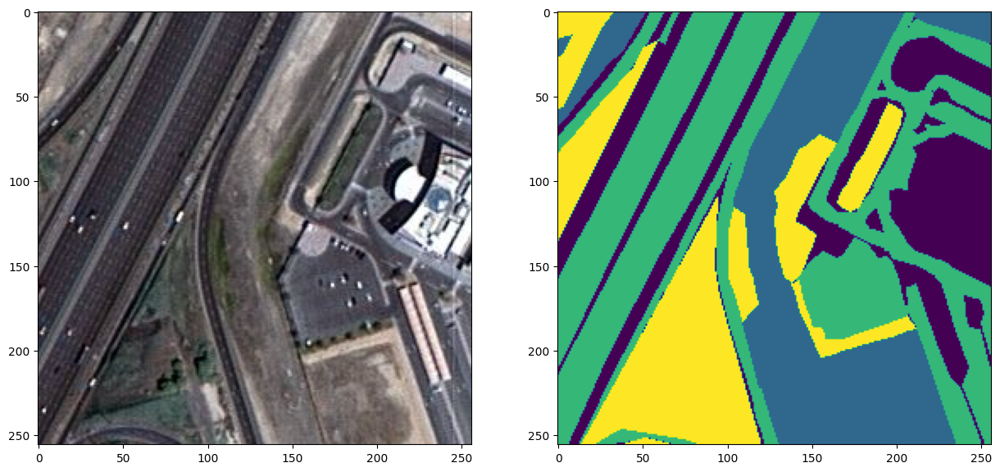

In [9]:
plt.figure(figsize=(15,10))
plt.subplot(1,2,1)
plt.imshow(x[0][0].permute(1,2,0))
plt.subplot(1,2,2)
plt.imshow(np.argmax(x[1][0].permute(1,2,0).numpy(), axis=2))

In [10]:
class DoubleConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(DoubleConv, self).__init__()
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
        )

    def forward(self, x):
        return self.double_conv(x)
    
    
class DownBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(DownBlock, self).__init__()
        self.double_conv = DoubleConv(in_channels, out_channels)
        self.down_sample = nn.MaxPool2d(2)

    def forward(self, x):
        skip_out = self.double_conv(x)
        down_out = self.down_sample(skip_out)
        return (down_out, skip_out)

    
class UpBlock(nn.Module):
    def __init__(self, in_channels, out_channels, up_sample_mode):
        super(UpBlock, self).__init__()
        if up_sample_mode == 'conv_transpose':
            self.up_sample = nn.ConvTranspose2d(in_channels-out_channels, in_channels-out_channels, kernel_size=2, stride=2)        
        elif up_sample_mode == 'bilinear':
            self.up_sample = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        else:
            raise ValueError("Unsupported `up_sample_mode` (can take one of `conv_transpose` or `bilinear`)")
        self.double_conv = DoubleConv(in_channels, out_channels)

    def forward(self, down_input, skip_input):
        x = self.up_sample(down_input)
        x = torch.cat([x, skip_input], dim=1)
        return self.double_conv(x)

    
class UNet(nn.Module):
    def __init__(self, out_classes=6, up_sample_mode='conv_transpose'):
        super(UNet, self).__init__()
        self.up_sample_mode = up_sample_mode
        # Downsampling Path
        self.down_conv1 = DownBlock(3, 64)
        self.down_conv2 = DownBlock(64, 128)
        self.down_conv3 = DownBlock(128, 256)
        self.down_conv4 = DownBlock(256, 512)
        # Bottleneck
        self.double_conv = DoubleConv(512, 1024)
        # Upsampling Path
        self.up_conv4 = UpBlock(512 + 1024, 512, self.up_sample_mode)
        self.up_conv3 = UpBlock(256 + 512, 256, self.up_sample_mode)
        self.up_conv2 = UpBlock(128 + 256, 128, self.up_sample_mode)
        self.up_conv1 = UpBlock(128 + 64, 64, self.up_sample_mode)
        # Final Convolution
        self.conv_last = nn.Conv2d(64, out_classes, kernel_size=1)

    def forward(self, x):
        x, skip1_out = self.down_conv1(x)
        x, skip2_out = self.down_conv2(x)
        x, skip3_out = self.down_conv3(x)
        x, skip4_out = self.down_conv4(x)
        x = self.double_conv(x)
        x = self.up_conv4(x, skip4_out)
        x = self.up_conv3(x, skip3_out)
        x = self.up_conv2(x, skip2_out)
        x = self.up_conv1(x, skip1_out)
        x = self.conv_last(x)
        return x
    

# Get UNet model
model = UNet()

In [11]:
class diceloss(torch.nn.Module):
    def init(self):
        super(diceloss, self).init()
    def forward(self,pred, target):
       smooth = 1e-6
       iflat = pred.contiguous().view(-1)
       torchlat = target.contiguous().view(-1)
       intersection = (iflat * torchlat).sum()
       A_sum = torch.sum(iflat * iflat)
       B_sum = torch.sum(torchlat * torchlat)
       return 1 - ((2. * intersection + smooth) / (A_sum + B_sum + smooth) )

In [12]:
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

optimizer = torch.optim.Adam([ 
    dict(params=model.parameters(), lr=0.0008),
])

criterion = diceloss()

In [13]:
def Train_model(
        model,
        data_loader,
        criterion,
        optim,
        metrix,
):
    losses= []
    iou = []
    localization_error=[]
    Jaccard = []
    model.train()
    for img , msk in data_loader:
        img, msk = img.to(DEVICE), msk.to(DEVICE)

        logits = model(img)
        loss = criterion(msk, logits)
        result = metrix.calculate(
            np.argmax(msk.squeeze().cpu().permute(2,3,1,0).numpy(), axis=2),
            np.argmax(logits.squeeze().detach().cpu().permute(2,3,1,0).numpy(),axis=2),
            strict=True,
            iou_threshold=0.7
        ) 
        optim.zero_grad()
        loss.backward()
        optim.step()
        losses.append(loss.detach().cpu()); iou.append(result.results.IoU);localization_error.append(result.results.localization_error);Jaccard.append(result.results.Jaccard)
    print(f"Train Loss: {np.array(losses).mean() :.4f} | Train IoU: {np.array(iou).mean() :4f} | Train Jaccard: {np.array(Jaccard).mean():4f} | Trian Localization Error: {np.array(localization_error).mean():4f}")
    return np.array(losses).mean(), np.array(iou).mean(), np.array(Jaccard).mean(), np.array(localization_error).mean()

def Test_model(
        model,
        data_loader,
        criterion,
        metrix,):
    losses= []
    iou = []
    localization_error=[]
    Jaccard = []
    model.eval()
    with torch.inference_mode():
        for img, msk in data_loader:
            img, msk = img.to(DEVICE), msk.to(DEVICE)
            logits = model(img)
            loss = criterion(logits, msk)
            result = metrix.calculate(
            np.argmax(msk.squeeze().cpu().permute(2,3,1,0).numpy(), axis=2),
            np.argmax(logits.squeeze().detach().cpu().permute(2,3,1,0).numpy(),axis=2),
            strict=True,
            iou_threshold=0.7
        ) 
            losses.append(loss.detach().cpu()); iou.append(result.results.IoU);localization_error.append(result.results.localization_error);Jaccard.append(result.results.Jaccard)
    print(f"Test Loss: {np.array(losses).mean() :.4f} | Test IoU: {np.array(iou).mean() :4f} | Test Jaccard: {np.array(Jaccard).mean():4f} | Test Localization Error: {np.array(localization_error).mean():4f}")
    return np.array(losses).mean(), np.array(iou).mean(), np.array(Jaccard).mean(), np.array(localization_error).mean()


In [14]:
losses = []
ious = []
localization_errors=[]
Jaccards = []
tlosses=[]
tiou = []
tlocalization_error=[]
tJaccard= []

In [15]:
pip install umetrix

Note: you may need to restart the kernel to use updated packages.


In [16]:
import umetrix

In [17]:
DEVICE


device(type='cuda')

In [18]:
from tqdm import tqdm

In [19]:
def conv_to_RGB_lbl(lbl):
    n_pred = torch.argmax(lbl,dim=0)
    BGR_classes = {'Water' :[226, 169, 41],
                            'Land' : [132, 41, 246],
                            'Road' : [110, 193, 228],
                            'Building' : [60, 16, 152],
                            'Vegetation' : [254, 221, 58],
                            'Unlabeled' : [155, 155, 155]} 
    single_patch_mask = n_pred
    label_seg = np.zeros((single_patch_mask.shape[0],single_patch_mask.shape[1],3), dtype=np.uint8)
    label_seg[single_patch_mask==0]=BGR_classes['Building']
    label_seg[single_patch_mask==1]=BGR_classes["Land"]
    label_seg[single_patch_mask==2]=BGR_classes["Road"]
    label_seg[single_patch_mask==3]=BGR_classes["Vegetation"]
    label_seg[single_patch_mask==4]=BGR_classes["Water"]
    label_seg[single_patch_mask==5]=BGR_classes["Unlabeled"]
    return label_seg

In [20]:
def conv_to_RGB(pred):
    n_pred = torch.argmax(pred, dim=1).squeeze().cpu()
    BGR_classes = {'Water' :[226, 169, 41],
                            'Land' : [132, 41, 246],
                            'Road' : [110, 193, 228],
                            'Building' : [60, 16, 152],
                            'Vegetation' : [254, 221, 58],
                            'Unlabeled' : [155, 155, 155]} 
    single_patch_mask = n_pred
    label_seg = np.zeros((single_patch_mask.shape[0],single_patch_mask.shape[1],3), dtype=np.uint8)
    label_seg[single_patch_mask==0]=BGR_classes['Building']
    label_seg[single_patch_mask==1]=BGR_classes["Land"]
    label_seg[single_patch_mask==2]=BGR_classes["Road"]
    label_seg[single_patch_mask==3]=BGR_classes["Vegetation"]
    label_seg[single_patch_mask==4]=BGR_classes["Water"]
    label_seg[single_patch_mask==5]=BGR_classes["Unlabeled"]
    return label_seg

In [21]:
model.to(DEVICE)
for i in tqdm(range(30)):
    print(f"{'#'*20} Epoch {i} {'#'*20}")
    print("Training....")
    l, iou, jaccard, le= Train_model(model, train_loader, criterion, optimizer, umetrix)
    losses.append(l); ious.append(iou); Jaccards.append(jaccard); localization_errors.append(le)
    print("Testing.......")
    lt, iout, jaccardt, let = Test_model(model, test_loader, criterion, umetrix)
    tlosses.append(lt); tiou.append(iout); tJaccard.append(jaccardt); tlocalization_error.append(let) 


  0%|          | 0/30 [00:00<?, ?it/s]

#################### Epoch 0 ####################
Training....
Train Loss: 0.2546 | Train IoU:  nan | Train Jaccard: 0.359574 | Trian Localization Error:  nan
Testing.......


  3%|▎         | 1/30 [02:35<1:15:00, 155.20s/it]

Test Loss: 0.2071 | Test IoU: 0.923234 | Test Jaccard: 0.809936 | Test Localization Error: 3.942603
#################### Epoch 1 ####################
Training....
Train Loss: 0.1806 | Train IoU: 0.907152 | Train Jaccard: 0.373366 | Trian Localization Error: 1.979655
Testing.......


  7%|▋         | 2/30 [04:14<57:12, 122.60s/it]  

Test Loss: 0.2015 | Test IoU: 0.891732 | Test Jaccard: 0.580791 | Test Localization Error: 5.268330
#################### Epoch 2 ####################
Training....
Train Loss: 0.1766 | Train IoU: 0.913134 | Train Jaccard: 0.346070 | Trian Localization Error: 1.953877
Testing.......


 10%|█         | 3/30 [05:49<49:25, 109.84s/it]

Test Loss: 0.1844 | Test IoU: 0.929496 | Test Jaccard: 0.666548 | Test Localization Error: 4.409847
#################### Epoch 3 ####################
Training....
Train Loss: 0.1744 | Train IoU: 0.913327 | Train Jaccard: 0.497783 | Trian Localization Error: 1.778723
Testing.......


 13%|█▎        | 4/30 [07:24<45:05, 104.07s/it]

Test Loss: 0.2207 | Test IoU:  nan | Test Jaccard: 0.492827 | Test Localization Error:  nan
#################### Epoch 4 ####################
Training....
Train Loss: 0.1601 | Train IoU: 0.919723 | Train Jaccard: 0.537388 | Trian Localization Error: 1.818422
Testing.......


 17%|█▋        | 5/30 [08:56<41:25, 99.44s/it] 

Test Loss: 0.1808 | Test IoU: 0.926826 | Test Jaccard: 0.697936 | Test Localization Error: 3.552181
#################### Epoch 5 ####################
Training....
Train Loss: 0.1532 | Train IoU: 0.920968 | Train Jaccard: 0.332424 | Trian Localization Error: 1.445535
Testing.......


 20%|██        | 6/30 [10:37<40:02, 100.10s/it]

Test Loss: 0.2125 | Test IoU:  nan | Test Jaccard: 0.423965 | Test Localization Error:  nan
#################### Epoch 6 ####################
Training....
Train Loss: 0.1627 | Train IoU: 0.918692 | Train Jaccard: 0.428143 | Trian Localization Error: 1.710050
Testing.......


 23%|██▎       | 7/30 [12:10<37:27, 97.70s/it] 

Test Loss: 0.1657 | Test IoU: 0.935827 | Test Jaccard: 0.800658 | Test Localization Error: 2.994718
#################### Epoch 7 ####################
Training....
Train Loss: 0.1531 | Train IoU: 0.923049 | Train Jaccard: 0.476482 | Trian Localization Error: 1.796905
Testing.......


 27%|██▋       | 8/30 [13:47<35:43, 97.44s/it]

Test Loss: 0.1762 | Test IoU: 0.892530 | Test Jaccard: 0.406387 | Test Localization Error: 5.631018
#################### Epoch 8 ####################
Training....
Train Loss: 0.1471 | Train IoU: 0.925744 | Train Jaccard: 0.524999 | Trian Localization Error: 1.645718
Testing.......


 30%|███       | 9/30 [15:18<33:28, 95.64s/it]

Test Loss: 0.1749 | Test IoU: 0.932433 | Test Jaccard: 0.746297 | Test Localization Error: 2.285823
#################### Epoch 9 ####################
Training....
Train Loss: 0.1459 | Train IoU: 0.925099 | Train Jaccard: 0.408314 | Trian Localization Error: 1.887541
Testing.......


 33%|███▎      | 10/30 [16:51<31:37, 94.85s/it]

Test Loss: 0.1604 | Test IoU: 0.938887 | Test Jaccard: 0.634282 | Test Localization Error: 3.618406
#################### Epoch 10 ####################
Training....
Train Loss: 0.1394 | Train IoU: 0.927788 | Train Jaccard: 0.456556 | Trian Localization Error: 2.025605
Testing.......


 37%|███▋      | 11/30 [18:22<29:36, 93.49s/it]

Test Loss: 0.1447 | Test IoU: 0.939886 | Test Jaccard: 0.720624 | Test Localization Error: 2.816632
#################### Epoch 11 ####################
Training....
Train Loss: 0.1427 | Train IoU: 0.925192 | Train Jaccard: 0.452269 | Trian Localization Error: 1.817246
Testing.......


 40%|████      | 12/30 [19:55<27:59, 93.32s/it]

Test Loss: 0.1539 | Test IoU: 0.934219 | Test Jaccard: 0.635922 | Test Localization Error: 3.210292
#################### Epoch 12 ####################
Training....
Train Loss: 0.1378 | Train IoU: 0.928982 | Train Jaccard: 0.504162 | Trian Localization Error: 1.607772
Testing.......


 43%|████▎     | 13/30 [21:25<26:10, 92.38s/it]

Test Loss: 0.1498 | Test IoU: 0.935390 | Test Jaccard: 0.692066 | Test Localization Error: 3.917689
#################### Epoch 13 ####################
Training....
Train Loss: 0.1375 | Train IoU: 0.928068 | Train Jaccard: 0.565804 | Trian Localization Error: 2.105246
Testing.......


 47%|████▋     | 14/30 [22:54<24:22, 91.38s/it]

Test Loss: 0.1543 | Test IoU: 0.939051 | Test Jaccard: 0.799402 | Test Localization Error: 3.635330
#################### Epoch 14 ####################
Training....
Train Loss: 0.1350 | Train IoU: 0.929851 | Train Jaccard: 0.551687 | Trian Localization Error: 1.631300
Testing.......


 50%|█████     | 15/30 [24:24<22:46, 91.10s/it]

Test Loss: 0.1515 | Test IoU: 0.935418 | Test Jaccard: 0.648306 | Test Localization Error: 2.653147
#################### Epoch 15 ####################
Training....
Train Loss: 0.1515 | Train IoU: 0.927041 | Train Jaccard: 0.545874 | Trian Localization Error: 1.674058
Testing.......


 53%|█████▎    | 16/30 [25:55<21:14, 91.05s/it]

Test Loss: 0.1442 | Test IoU: 0.938603 | Test Jaccard: 0.722900 | Test Localization Error: 4.273710
#################### Epoch 16 ####################
Training....
Train Loss: 0.1335 | Train IoU: 0.929468 | Train Jaccard: 0.562064 | Trian Localization Error: 1.396485
Testing.......


 57%|█████▋    | 17/30 [27:24<19:35, 90.39s/it]

Test Loss: 0.1449 | Test IoU: 0.939031 | Test Jaccard: 0.745195 | Test Localization Error: 2.245192
#################### Epoch 17 ####################
Training....
Train Loss: 0.1323 | Train IoU: 0.932625 | Train Jaccard: 0.541194 | Trian Localization Error: 1.378149
Testing.......


 60%|██████    | 18/30 [28:53<17:59, 89.94s/it]

Test Loss: 0.1412 | Test IoU: 0.933972 | Test Jaccard: 0.668815 | Test Localization Error: 2.829572
#################### Epoch 18 ####################
Training....
Train Loss: 0.1376 | Train IoU: 0.930603 | Train Jaccard: 0.540056 | Trian Localization Error: 1.364288
Testing.......


 63%|██████▎   | 19/30 [30:23<16:27, 89.79s/it]

Test Loss: 0.1664 | Test IoU: 0.934254 | Test Jaccard: 0.729565 | Test Localization Error: 3.626104
#################### Epoch 19 ####################
Training....
Train Loss: 0.1335 | Train IoU: 0.931337 | Train Jaccard: 0.532792 | Trian Localization Error: 1.374450
Testing.......


 67%|██████▋   | 20/30 [31:53<14:58, 89.88s/it]

Test Loss: 0.1468 | Test IoU: 0.940926 | Test Jaccard: 0.593162 | Test Localization Error: 2.777518
#################### Epoch 20 ####################
Training....
Train Loss: 0.1318 | Train IoU: 0.928679 | Train Jaccard: 0.441004 | Trian Localization Error: 1.468689
Testing.......


 70%|███████   | 21/30 [33:26<13:38, 90.94s/it]

Test Loss: 0.1419 | Test IoU: 0.934027 | Test Jaccard: 0.776366 | Test Localization Error: 3.684397
#################### Epoch 21 ####################
Training....
Train Loss: 0.1270 | Train IoU: 0.931563 | Train Jaccard: 0.617160 | Trian Localization Error: 1.572238
Testing.......


 73%|███████▎  | 22/30 [34:54<12:01, 90.14s/it]

Test Loss: 0.1404 | Test IoU: 0.940470 | Test Jaccard: 0.846369 | Test Localization Error: 3.303787
#################### Epoch 22 ####################
Training....
Train Loss: 0.1279 | Train IoU: 0.934208 | Train Jaccard: 0.455495 | Trian Localization Error: 1.326910
Testing.......


 77%|███████▋  | 23/30 [36:22<10:25, 89.36s/it]

Test Loss: 0.1398 | Test IoU: 0.941885 | Test Jaccard: 0.745883 | Test Localization Error: 3.128566
#################### Epoch 23 ####################
Training....
Train Loss: 0.1229 | Train IoU: 0.934715 | Train Jaccard: 0.600018 | Trian Localization Error: 1.155412
Testing.......


 80%|████████  | 24/30 [37:51<08:56, 89.42s/it]

Test Loss: 0.1371 | Test IoU: 0.926476 | Test Jaccard: 0.645340 | Test Localization Error: 3.539301
#################### Epoch 24 ####################
Training....
Train Loss: 0.1244 | Train IoU: 0.935558 | Train Jaccard: 0.661860 | Trian Localization Error: 1.136065
Testing.......


 83%|████████▎ | 25/30 [39:17<07:21, 88.31s/it]

Test Loss: 0.1638 | Test IoU: 0.931056 | Test Jaccard: 0.813782 | Test Localization Error: 4.113375
#################### Epoch 25 ####################
Training....
Train Loss: 0.1235 | Train IoU: 0.934489 | Train Jaccard: 0.546404 | Trian Localization Error: 1.555206
Testing.......


 87%|████████▋ | 26/30 [40:48<05:56, 89.05s/it]

Test Loss: 0.1436 | Test IoU: 0.939256 | Test Jaccard: 0.806822 | Test Localization Error: 3.732776
#################### Epoch 26 ####################
Training....
Train Loss: 0.1228 | Train IoU: 0.933929 | Train Jaccard: 0.564234 | Trian Localization Error: 1.432544
Testing.......


 90%|█████████ | 27/30 [42:17<04:27, 89.12s/it]

Test Loss: 0.1323 | Test IoU: 0.941062 | Test Jaccard: 0.823151 | Test Localization Error: 3.060914
#################### Epoch 27 ####################
Training....
Train Loss: 0.1232 | Train IoU: 0.934194 | Train Jaccard: 0.539223 | Trian Localization Error: 1.564780
Testing.......


 93%|█████████▎| 28/30 [43:48<02:59, 89.52s/it]

Test Loss: 0.1592 | Test IoU: 0.932312 | Test Jaccard: 0.810120 | Test Localization Error: 2.283042
#################### Epoch 28 ####################
Training....
Train Loss: 0.1251 | Train IoU: 0.934321 | Train Jaccard: 0.564709 | Trian Localization Error: 1.073744
Testing.......


 97%|█████████▋| 29/30 [45:17<01:29, 89.39s/it]

Test Loss: 0.1374 | Test IoU: 0.940721 | Test Jaccard: 0.742851 | Test Localization Error: 3.262305
#################### Epoch 29 ####################
Training....
Train Loss: 0.1268 | Train IoU: 0.934132 | Train Jaccard: 0.588209 | Trian Localization Error: 1.786358
Testing.......


100%|██████████| 30/30 [46:46<00:00, 93.56s/it]

Test Loss: 0.1399 | Test IoU: 0.938664 | Test Jaccard: 0.796060 | Test Localization Error: 2.079183


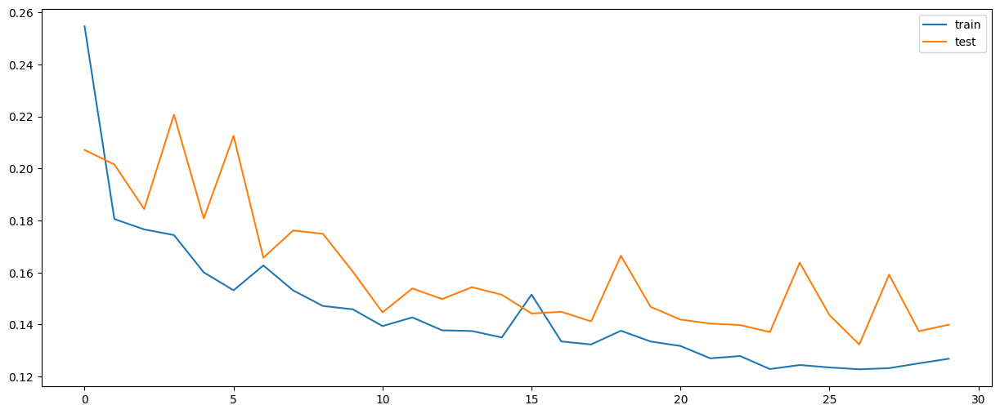

In [22]:
plt.figure(figsize=(15,6))
plt.plot(losses, label="train")
plt.plot(tlosses, label="test")
plt.legend()

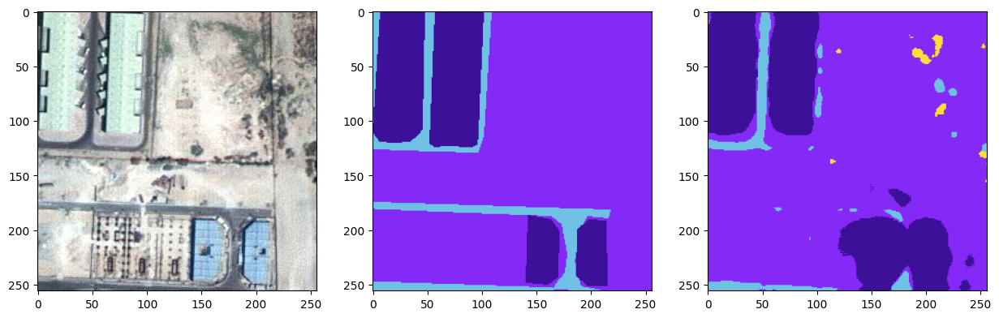

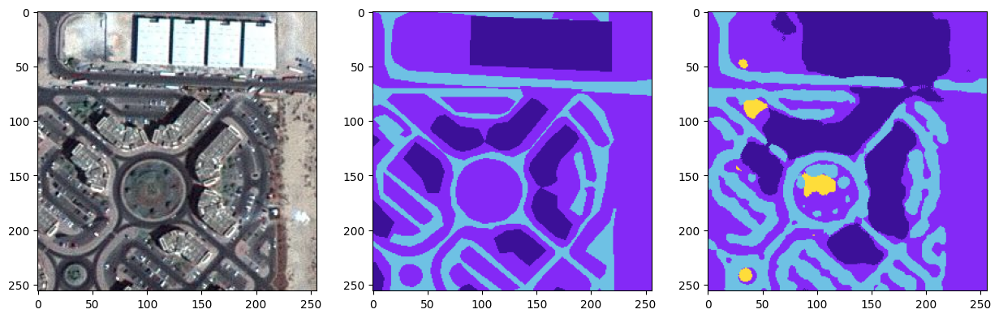

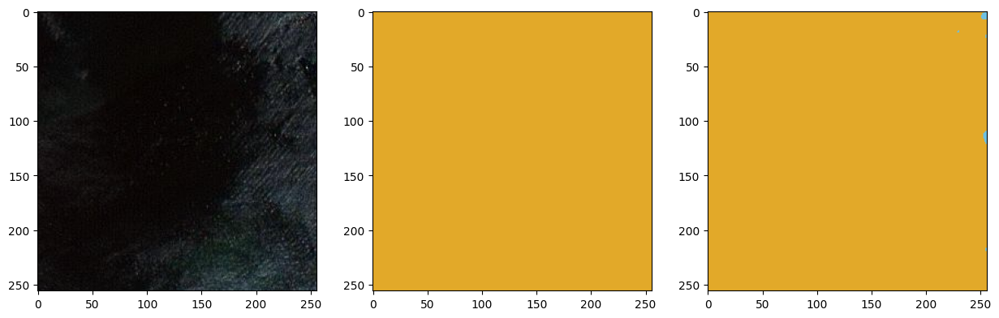

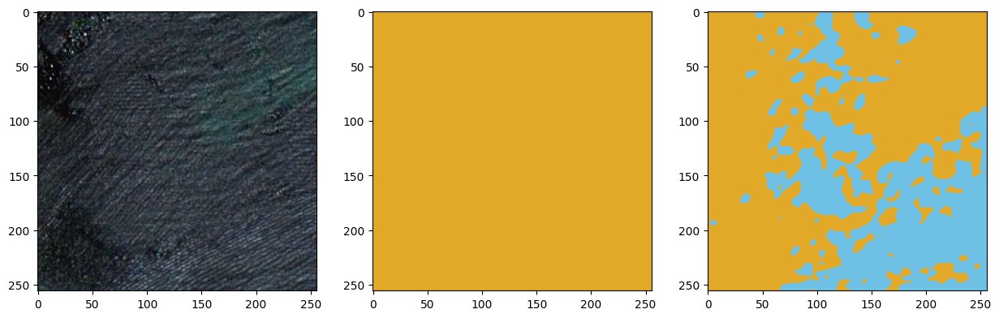

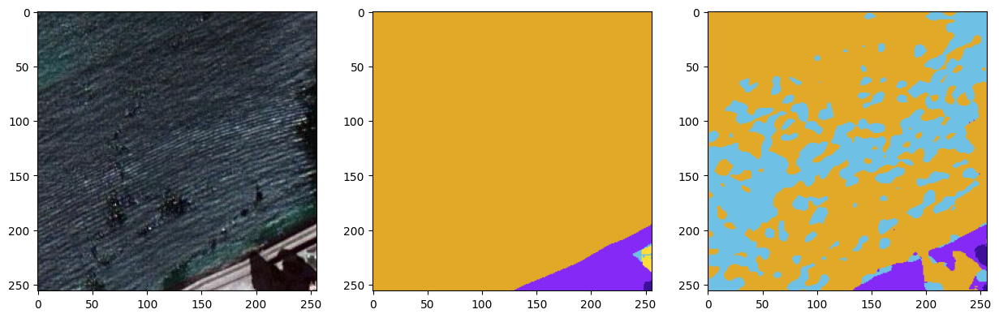

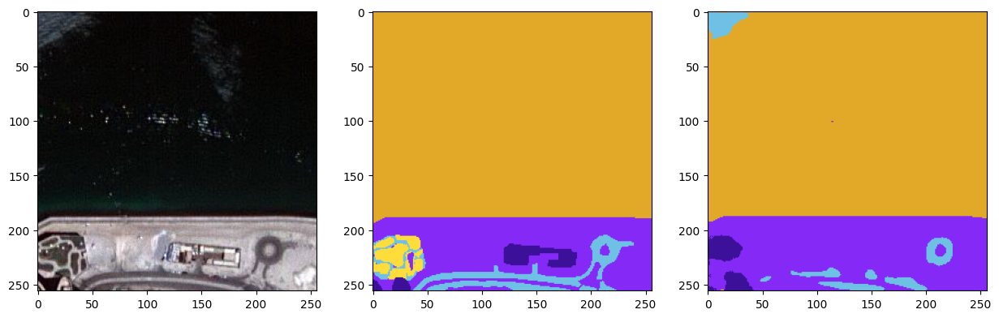

In [23]:
model.eval()
n=6
with torch.inference_mode():
    for i, img in enumerate(Test_data.np_images[:n]):
        pred=model(img.unsqueeze(dim=0).to(DEVICE))
        plt.figure(figsize=(95,40))
        plt.subplot(1,n*3,i+1 if i%2==0 else i+3)
        plt.imshow(img.cpu().permute(1,2,0)) 
        plt.subplot(1,n*3,i+2 if i%2==0 else i+4)
        plt.imshow(conv_to_RGB_lbl(Test_data.np_masks[i])) 
        plt.subplot(1,n*3,i+3 if i%2==0 else i+5)
        plt.imshow(conv_to_RGB(pred))
        if i%2==1:
            plt.show()
        

In [24]:
images = sorted(glob.glob("/kaggle/input/semantic-segmentation-of-aerial-imagery/Semantic segmentation dataset/Tile 1/images/*"))
masks = sorted(glob.glob("/kaggle/input/semantic-segmentation-of-aerial-imagery/Semantic segmentation dataset/Tile 1/masks/*"))

In [25]:
full_image_test= CustomData_test(images, masks)

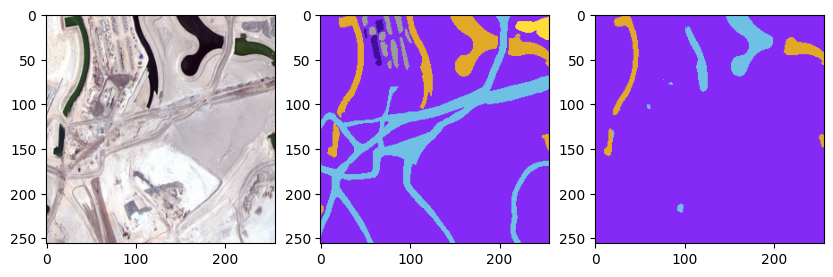

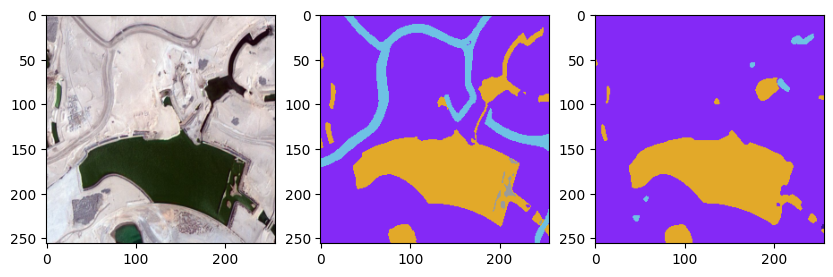

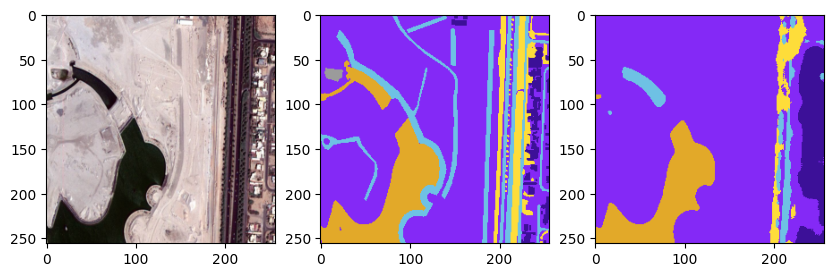

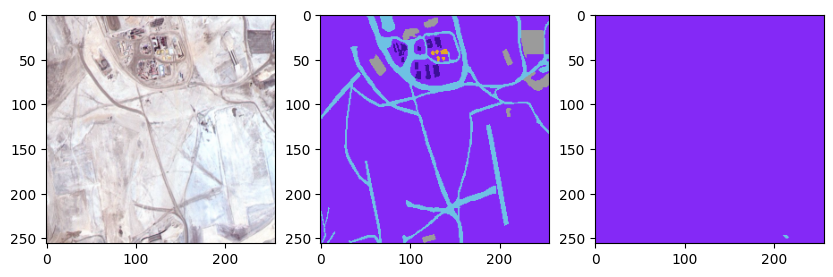

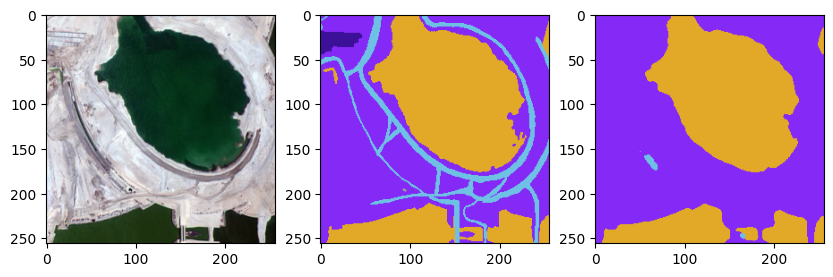

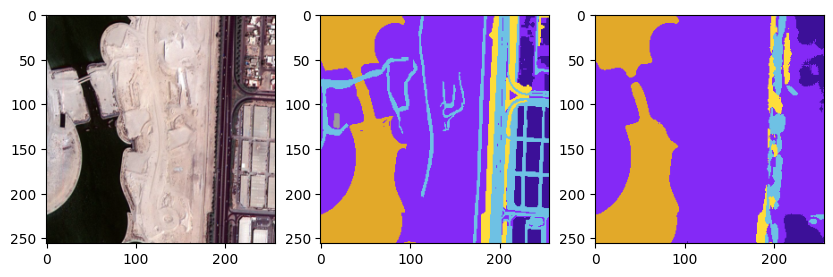

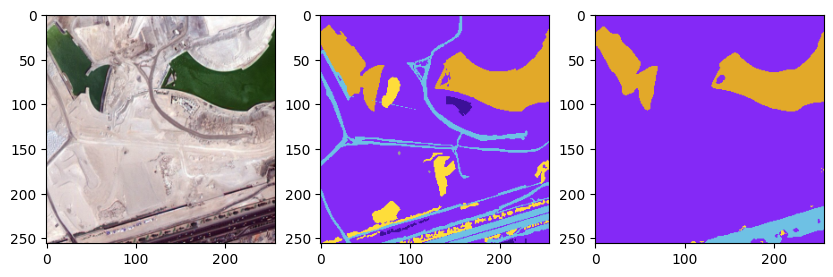

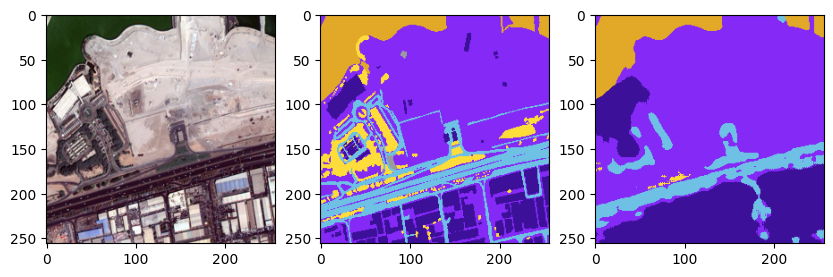

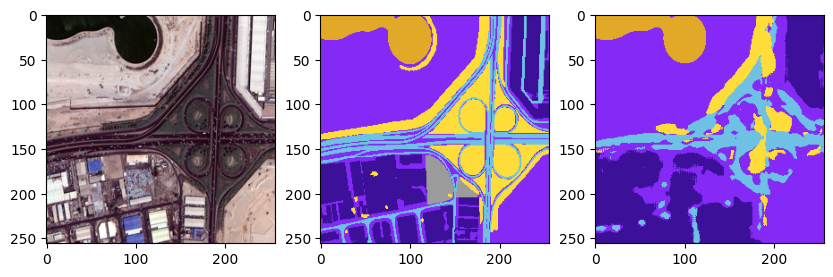

In [26]:
model.eval()
n= len(full_image_test)
with torch.inference_mode():
    for i, img in enumerate(full_image_test.np_images):
        pred=model(img.unsqueeze(dim=0).to(DEVICE))
        plt.figure(figsize=(95,40))
        plt.subplot(1,n*3,i+1 if i%2==0 else i+3)
        plt.imshow(img.cpu().permute(1,2,0)) 
        plt.subplot(1,n*3,i+2 if i%2==0 else i+4)
        plt.imshow(conv_to_RGB_lbl(full_image_test.np_masks[i])) 
        plt.subplot(1,n*3,i+3 if i%2==0 else i+5)
        plt.imshow(conv_to_RGB(pred))
        if i%2==1:
            plt.show()
        

In [27]:
model.to(DEVICE)
for i in tqdm(range(30)):
    print(f"{'#'*20} Epoch {i} {'#'*20}")
    print("Training....")
    l, iou, jaccard, le= Train_model(model, train_loader, criterion, optimizer, umetrix)
    losses.append(l); ious.append(iou); Jaccards.append(jaccard); localization_errors.append(le)
    print("Testing.......")
    lt, iout, jaccardt, let = Test_model(model, test_loader, criterion, umetrix)
    tlosses.append(lt); tiou.append(iout); tJaccard.append(jaccardt); tlocalization_error.append(let) 


  0%|          | 0/30 [00:00<?, ?it/s]

#################### Epoch 0 ####################
Training....
Train Loss: 0.1198 | Train IoU: 0.936045 | Train Jaccard: 0.589983 | Trian Localization Error: 1.322757
Testing.......


  3%|▎         | 1/30 [01:30<43:38, 90.29s/it]

Test Loss: 0.1315 | Test IoU: 0.938668 | Test Jaccard: 0.815022 | Test Localization Error: 3.235004
#################### Epoch 1 ####################
Training....
Train Loss: 0.1156 | Train IoU: 0.938041 | Train Jaccard: 0.587144 | Trian Localization Error: 1.445495
Testing.......


  7%|▋         | 2/30 [02:57<41:14, 88.39s/it]

Test Loss: 0.1365 | Test IoU: 0.945555 | Test Jaccard: 0.783845 | Test Localization Error: 2.121718
#################### Epoch 2 ####################
Training....
Train Loss: 0.1210 | Train IoU: 0.934997 | Train Jaccard: 0.495228 | Trian Localization Error: 1.452604
Testing.......


 10%|█         | 3/30 [04:25<39:43, 88.28s/it]

Test Loss: 0.1317 | Test IoU: 0.941514 | Test Jaccard: 0.762063 | Test Localization Error: 2.794092
#################### Epoch 3 ####################
Training....
Train Loss: 0.1170 | Train IoU: 0.938179 | Train Jaccard: 0.602019 | Trian Localization Error: 1.062646
Testing.......


 13%|█▎        | 4/30 [05:54<38:18, 88.42s/it]

Test Loss: 0.1293 | Test IoU: 0.943430 | Test Jaccard: 0.764652 | Test Localization Error: 2.228673
#################### Epoch 4 ####################
Training....
Train Loss: 0.1202 | Train IoU: 0.937975 | Train Jaccard: 0.529584 | Trian Localization Error: 1.416148
Testing.......


 17%|█▋        | 5/30 [07:24<37:03, 88.95s/it]

Test Loss: 0.1275 | Test IoU: 0.942551 | Test Jaccard: 0.765840 | Test Localization Error: 1.691939
#################### Epoch 5 ####################
Training....
Train Loss: 0.1161 | Train IoU: 0.938014 | Train Jaccard: 0.559106 | Trian Localization Error: 1.238754
Testing.......


 20%|██        | 6/30 [08:50<35:13, 88.08s/it]

Test Loss: 0.1540 | Test IoU: 0.923945 | Test Jaccard: 0.618754 | Test Localization Error: 2.866084
#################### Epoch 6 ####################
Training....
Train Loss: 0.1164 | Train IoU: 0.937770 | Train Jaccard: 0.566275 | Trian Localization Error: 1.067569
Testing.......


 23%|██▎       | 7/30 [10:19<33:50, 88.27s/it]

Test Loss: 0.1306 | Test IoU: 0.943483 | Test Jaccard: 0.691191 | Test Localization Error: 2.308452
#################### Epoch 7 ####################
Training....
Train Loss: 0.1167 | Train IoU: 0.936977 | Train Jaccard: 0.657671 | Trian Localization Error: 1.392226
Testing.......


 27%|██▋       | 8/30 [11:46<32:18, 88.12s/it]

Test Loss: 0.1287 | Test IoU: 0.943461 | Test Jaccard: 0.637859 | Test Localization Error: 3.108240
#################### Epoch 8 ####################
Training....
Train Loss: 0.1171 | Train IoU: 0.938802 | Train Jaccard: 0.612080 | Trian Localization Error: 1.007690
Testing.......


 30%|███       | 9/30 [13:14<30:48, 88.04s/it]

Test Loss: 0.1290 | Test IoU: 0.939992 | Test Jaccard: 0.717788 | Test Localization Error: 3.412212
#################### Epoch 9 ####################
Training....
Train Loss: 0.1114 | Train IoU: 0.940024 | Train Jaccard: 0.589613 | Trian Localization Error: 1.257205
Testing.......


 33%|███▎      | 10/30 [14:42<29:21, 88.07s/it]

Test Loss: 0.1263 | Test IoU: 0.945983 | Test Jaccard: 0.825118 | Test Localization Error: 2.137602
#################### Epoch 10 ####################
Training....
Train Loss: 0.1120 | Train IoU: 0.938993 | Train Jaccard: 0.534376 | Trian Localization Error: 1.275291
Testing.......


 37%|███▋      | 11/30 [16:11<27:58, 88.34s/it]

Test Loss: 0.1322 | Test IoU: 0.945730 | Test Jaccard: 0.736841 | Test Localization Error: 1.674925
#################### Epoch 11 ####################
Training....
Train Loss: 0.1138 | Train IoU: 0.939508 | Train Jaccard: 0.493086 | Trian Localization Error: 1.035874
Testing.......


 40%|████      | 12/30 [17:41<26:37, 88.75s/it]

Test Loss: 0.1371 | Test IoU: 0.943926 | Test Jaccard: 0.811635 | Test Localization Error: 2.730276
#################### Epoch 12 ####################
Training....
Train Loss: 0.1139 | Train IoU: 0.940645 | Train Jaccard: 0.703078 | Trian Localization Error: 1.097332
Testing.......


 43%|████▎     | 13/30 [19:10<25:08, 88.71s/it]

Test Loss: 0.1215 | Test IoU: 0.945270 | Test Jaccard: 0.634376 | Test Localization Error: 1.713458
#################### Epoch 13 ####################
Training....
Train Loss: 0.1116 | Train IoU: 0.940345 | Train Jaccard: 0.660268 | Trian Localization Error: 1.272015
Testing.......


 47%|████▋     | 14/30 [20:36<23:27, 88.00s/it]

Test Loss: 0.1221 | Test IoU: 0.939242 | Test Jaccard: 0.652071 | Test Localization Error: 2.808725
#################### Epoch 14 ####################
Training....
Train Loss: 0.1112 | Train IoU: 0.940496 | Train Jaccard: 0.616244 | Trian Localization Error: 1.287020
Testing.......


 50%|█████     | 15/30 [22:02<21:51, 87.43s/it]

Test Loss: 0.1247 | Test IoU: 0.943878 | Test Jaccard: 0.792645 | Test Localization Error: 2.827811
#################### Epoch 15 ####################
Training....
Train Loss: 0.1087 | Train IoU: 0.942508 | Train Jaccard: 0.635413 | Trian Localization Error: 1.185703
Testing.......


 53%|█████▎    | 16/30 [23:31<20:32, 88.01s/it]

Test Loss: 0.1315 | Test IoU: 0.948180 | Test Jaccard: 0.771228 | Test Localization Error: 2.234336
#################### Epoch 16 ####################
Training....
Train Loss: 0.1097 | Train IoU: 0.940626 | Train Jaccard: 0.568343 | Trian Localization Error: 0.895224
Testing.......


 57%|█████▋    | 17/30 [24:58<19:00, 87.71s/it]

Test Loss: 0.1185 | Test IoU: 0.946486 | Test Jaccard: 0.762340 | Test Localization Error: 2.385511
#################### Epoch 17 ####################
Training....
Train Loss: 0.1055 | Train IoU: 0.941097 | Train Jaccard: 0.628008 | Trian Localization Error: 1.010899
Testing.......


 60%|██████    | 18/30 [26:27<17:35, 87.94s/it]

Test Loss: 0.1195 | Test IoU: 0.941169 | Test Jaccard: 0.694017 | Test Localization Error: 3.439082
#################### Epoch 18 ####################
Training....
Train Loss: 0.1065 | Train IoU: 0.942937 | Train Jaccard: 0.639186 | Trian Localization Error: 1.154683
Testing.......


 63%|██████▎   | 19/30 [27:54<16:04, 87.70s/it]

Test Loss: 0.1129 | Test IoU: 0.947804 | Test Jaccard: 0.862393 | Test Localization Error: 1.915892
#################### Epoch 19 ####################
Training....
Train Loss: 0.1086 | Train IoU: 0.942693 | Train Jaccard: 0.704768 | Trian Localization Error: 1.062058
Testing.......


 67%|██████▋   | 20/30 [29:20<14:32, 87.24s/it]

Test Loss: 0.1258 | Test IoU: 0.947488 | Test Jaccard: 0.761508 | Test Localization Error: 4.006373
#################### Epoch 20 ####################
Training....
Train Loss: 0.1034 | Train IoU: 0.945496 | Train Jaccard: 0.640155 | Trian Localization Error: 1.046759
Testing.......


 70%|███████   | 21/30 [30:46<12:59, 86.66s/it]

Test Loss: 0.1153 | Test IoU: 0.946446 | Test Jaccard: 0.814423 | Test Localization Error: 2.319940
#################### Epoch 21 ####################
Training....
Train Loss: 0.1044 | Train IoU: 0.942959 | Train Jaccard: 0.600228 | Trian Localization Error: 1.202136
Testing.......


 73%|███████▎  | 22/30 [32:12<11:32, 86.59s/it]

Test Loss: 0.1151 | Test IoU: 0.949196 | Test Jaccard: 0.737511 | Test Localization Error: 1.924925
#################### Epoch 22 ####################
Training....
Train Loss: 0.1039 | Train IoU: 0.944983 | Train Jaccard: 0.712055 | Trian Localization Error: 1.073866
Testing.......


 77%|███████▋  | 23/30 [33:40<10:08, 86.89s/it]

Test Loss: 0.1228 | Test IoU: 0.939703 | Test Jaccard: 0.648754 | Test Localization Error: 2.556609
#################### Epoch 23 ####################
Training....
Train Loss: 0.1035 | Train IoU: 0.945105 | Train Jaccard: 0.637841 | Trian Localization Error: 0.881114
Testing.......


 80%|████████  | 24/30 [35:07<08:43, 87.19s/it]

Test Loss: 0.1189 | Test IoU: 0.947393 | Test Jaccard: 0.757205 | Test Localization Error: 1.932514
#################### Epoch 24 ####################
Training....
Train Loss: 0.1046 | Train IoU: 0.944857 | Train Jaccard: 0.647055 | Trian Localization Error: 1.125723
Testing.......


 83%|████████▎ | 25/30 [36:32<07:12, 86.48s/it]

Test Loss: 0.1380 | Test IoU: 0.933673 | Test Jaccard: 0.854808 | Test Localization Error: 4.333138
#################### Epoch 25 ####################
Training....
Train Loss: 0.1044 | Train IoU: 0.944327 | Train Jaccard: 0.582809 | Trian Localization Error: 1.069636
Testing.......


 87%|████████▋ | 26/30 [37:59<05:45, 86.43s/it]

Test Loss: 0.1255 | Test IoU: 0.945066 | Test Jaccard: 0.821795 | Test Localization Error: 1.866908
#################### Epoch 26 ####################
Training....
Train Loss: 0.1036 | Train IoU: 0.944988 | Train Jaccard: 0.698884 | Trian Localization Error: 1.124603
Testing.......


 90%|█████████ | 27/30 [39:24<04:18, 86.23s/it]

Test Loss: 0.1150 | Test IoU: 0.949773 | Test Jaccard: 0.805153 | Test Localization Error: 1.474130
#################### Epoch 27 ####################
Training....
Train Loss: 0.1035 | Train IoU: 0.943927 | Train Jaccard: 0.637312 | Trian Localization Error: 0.919151
Testing.......


 93%|█████████▎| 28/30 [40:50<02:52, 86.16s/it]

Test Loss: 0.1150 | Test IoU: 0.943517 | Test Jaccard: 0.777273 | Test Localization Error: 1.975558
#################### Epoch 28 ####################
Training....
Train Loss: 0.0980 | Train IoU: 0.947564 | Train Jaccard: 0.651635 | Trian Localization Error: 0.950818
Testing.......


 97%|█████████▋| 29/30 [42:18<01:26, 86.71s/it]

Test Loss: 0.1119 | Test IoU: 0.944435 | Test Jaccard: 0.896154 | Test Localization Error: 1.889722
#################### Epoch 29 ####################
Training....
Train Loss: 0.1017 | Train IoU: 0.946417 | Train Jaccard: 0.694547 | Trian Localization Error: 0.962723
Testing.......


100%|██████████| 30/30 [43:44<00:00, 87.47s/it]

Test Loss: 0.1104 | Test IoU: 0.947934 | Test Jaccard: 0.793155 | Test Localization Error: 2.497577


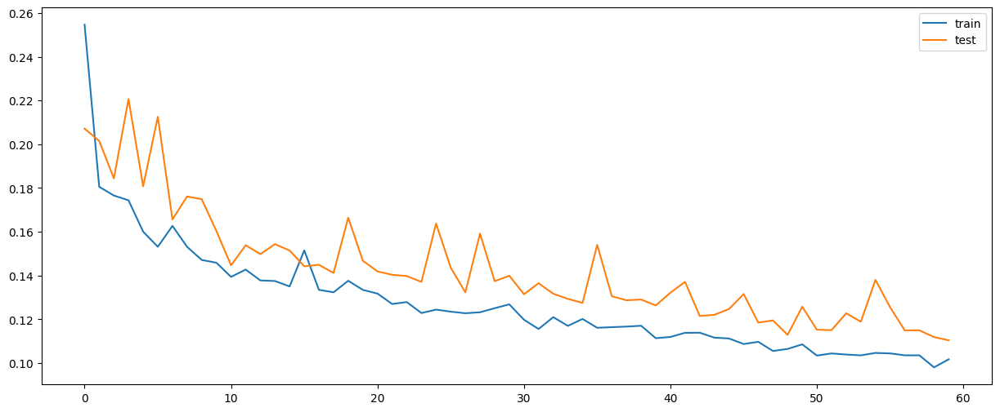

In [28]:
plt.figure(figsize=(15,6))
plt.plot(losses, label="train")
plt.plot(tlosses, label="test")
plt.legend()

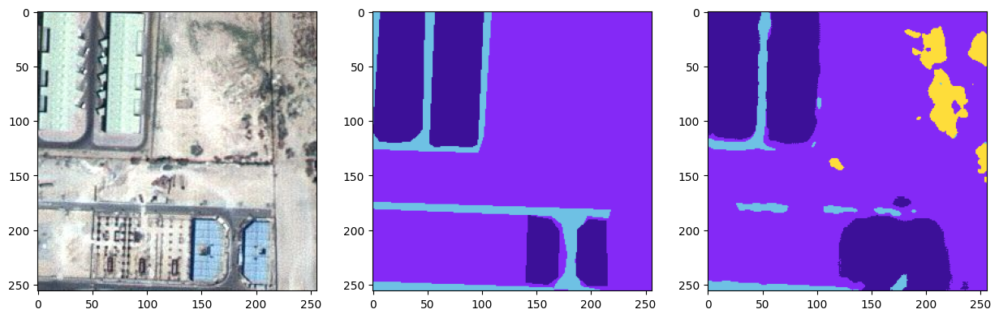

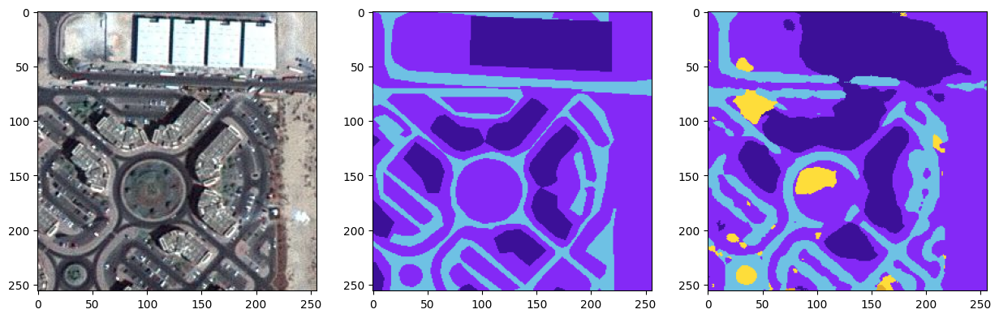

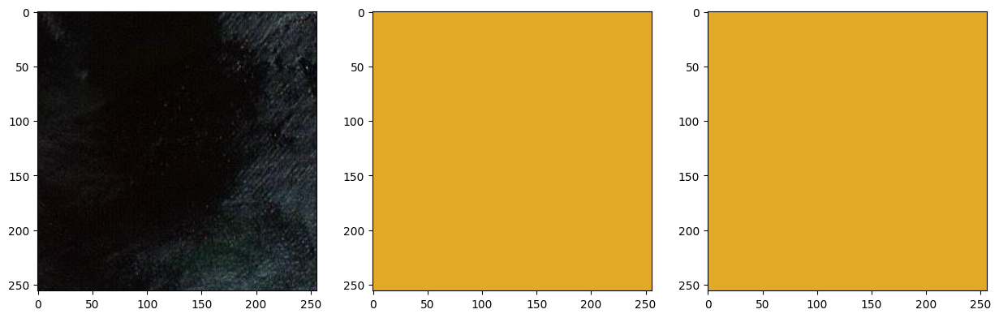

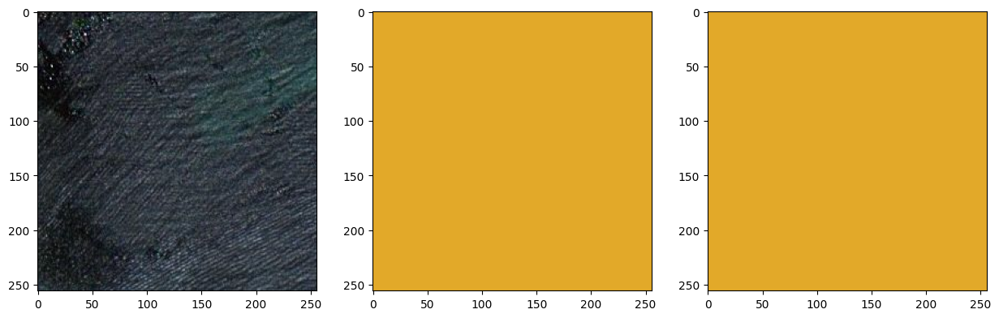

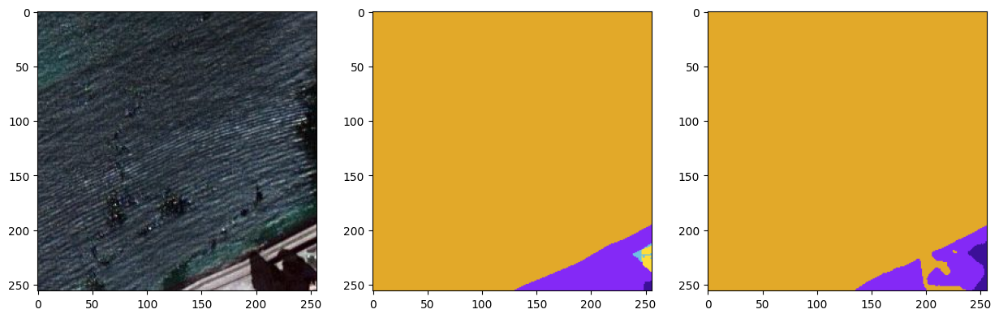

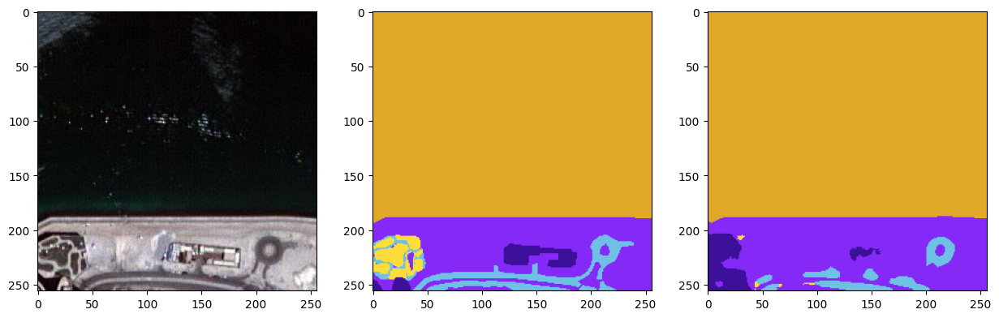

In [29]:
model.eval()
n=6
with torch.inference_mode():
    for i, img in enumerate(Test_data.np_images[:n]):
        pred=model(img.unsqueeze(dim=0).to(DEVICE))
        plt.figure(figsize=(95,40))
        plt.subplot(1,n*3,i+1 if i%2==0 else i+3)
        plt.imshow(img.cpu().permute(1,2,0)) 
        plt.subplot(1,n*3,i+2 if i%2==0 else i+4)
        plt.imshow(conv_to_RGB_lbl(Test_data.np_masks[i])) 
        plt.subplot(1,n*3,i+3 if i%2==0 else i+5)
        plt.imshow(conv_to_RGB(pred))
        if i%2==1:
            plt.show()
        

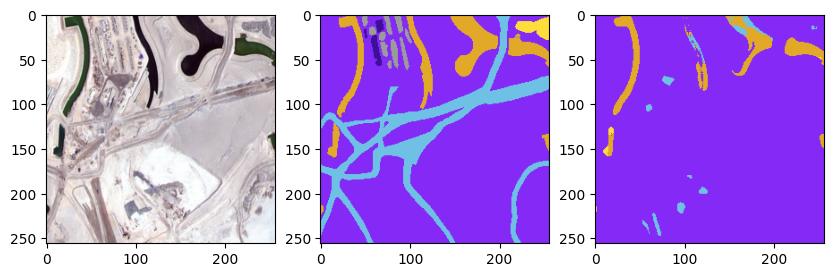

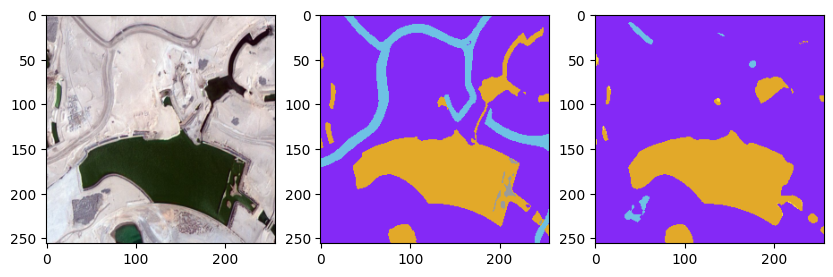

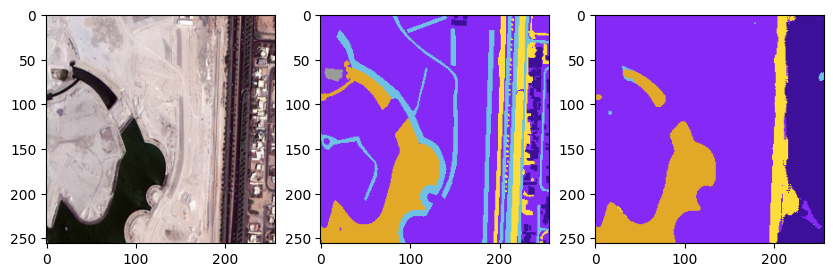

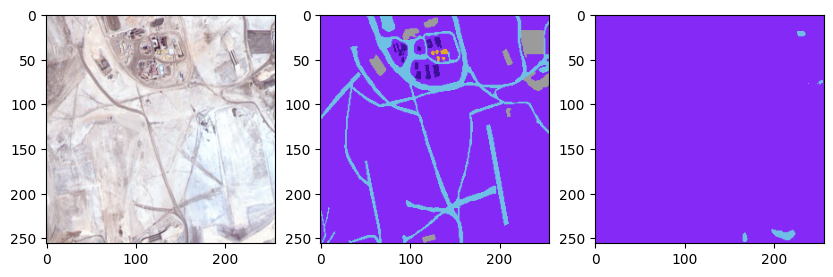

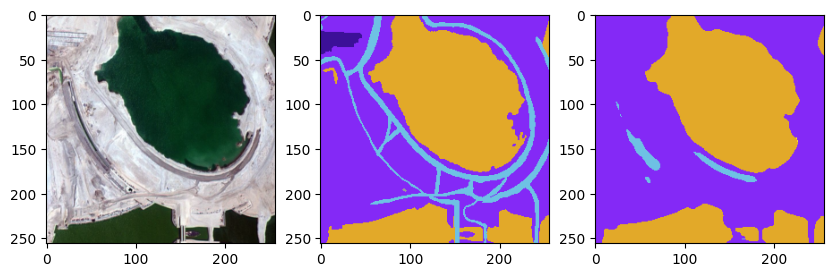

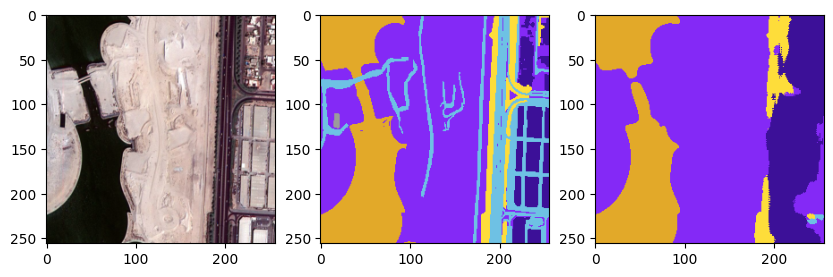

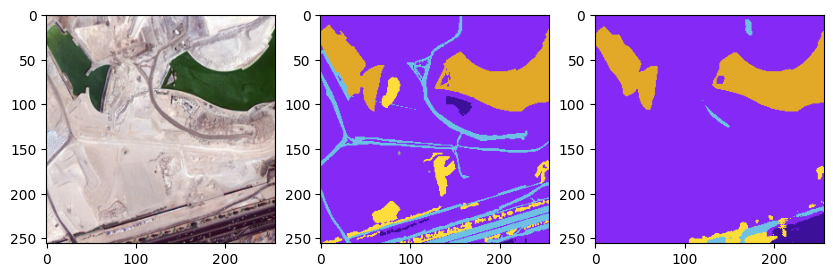

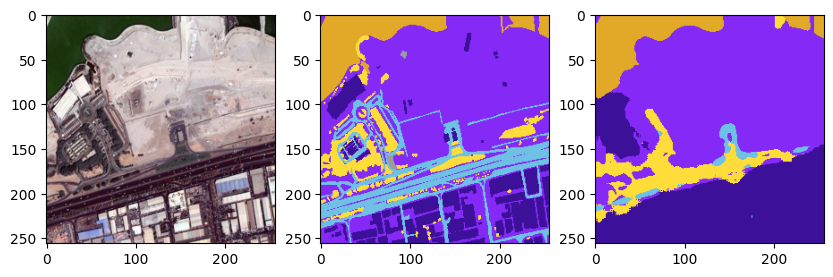

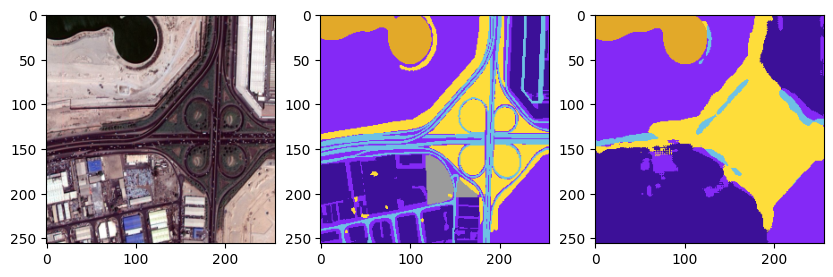

In [30]:
model.eval()
n= len(full_image_test)
with torch.inference_mode():
    for i, img in enumerate(full_image_test.np_images):
        pred=model(img.unsqueeze(dim=0).to(DEVICE))
        plt.figure(figsize=(95,40))
        plt.subplot(1,n*3,i+1 if i%2==0 else i+3)
        plt.imshow(img.cpu().permute(1,2,0)) 
        plt.subplot(1,n*3,i+2 if i%2==0 else i+4)
        plt.imshow(conv_to_RGB_lbl(full_image_test.np_masks[i])) 
        plt.subplot(1,n*3,i+3 if i%2==0 else i+5)
        plt.imshow(conv_to_RGB(pred))
        if i%2==1:
            plt.show()
        

In [31]:
model.to(DEVICE)
for i in tqdm(range(30)):
    print(f"{'#'*20} Epoch {i} {'#'*20}")
    print("Training....")
    l, iou, jaccard, le= Train_model(model, train_loader, criterion, optimizer, umetrix)
    losses.append(l); ious.append(iou); Jaccards.append(jaccard); localization_errors.append(le)
    print("Testing.......")
    lt, iout, jaccardt, let = Test_model(model, test_loader, criterion, umetrix)
    tlosses.append(lt); tiou.append(iout); tJaccard.append(jaccardt); tlocalization_error.append(let) 


  0%|          | 0/30 [00:00<?, ?it/s]

#################### Epoch 0 ####################
Training....
Train Loss: 0.0976 | Train IoU: 0.949264 | Train Jaccard: 0.681556 | Trian Localization Error: 0.727793
Testing.......


  3%|▎         | 1/30 [01:28<42:45, 88.47s/it]

Test Loss: 0.1107 | Test IoU: 0.946197 | Test Jaccard: 0.892308 | Test Localization Error: 3.046017
#################### Epoch 1 ####################
Training....
Train Loss: 0.1026 | Train IoU: 0.943247 | Train Jaccard: 0.584556 | Trian Localization Error: 0.945890
Testing.......


  7%|▋         | 2/30 [02:57<41:25, 88.76s/it]

Test Loss: 0.1310 | Test IoU: 0.949464 | Test Jaccard: 0.757639 | Test Localization Error: 3.404880
#################### Epoch 2 ####################
Training....
Train Loss: 0.1032 | Train IoU: 0.947035 | Train Jaccard: 0.684749 | Trian Localization Error: 1.106455
Testing.......


 10%|█         | 3/30 [04:22<39:13, 87.17s/it]

Test Loss: 0.1066 | Test IoU: 0.949671 | Test Jaccard: 0.813753 | Test Localization Error: 1.522164
#################### Epoch 3 ####################
Training....
Train Loss: 0.0984 | Train IoU: 0.947922 | Train Jaccard: 0.606707 | Trian Localization Error: 1.129568
Testing.......


 13%|█▎        | 4/30 [05:51<38:05, 87.92s/it]

Test Loss: 0.1080 | Test IoU: 0.949999 | Test Jaccard: 0.874145 | Test Localization Error: 2.506442
#################### Epoch 4 ####################
Training....
Train Loss: 0.0973 | Train IoU: 0.949223 | Train Jaccard: 0.672132 | Trian Localization Error: 0.861242
Testing.......


 17%|█▋        | 5/30 [07:17<36:13, 86.96s/it]

Test Loss: 0.1115 | Test IoU: 0.948393 | Test Jaccard: 0.690233 | Test Localization Error: 2.809306
#################### Epoch 5 ####################
Training....
Train Loss: 0.0962 | Train IoU: 0.949709 | Train Jaccard: 0.695624 | Trian Localization Error: 0.589114
Testing.......


 20%|██        | 6/30 [08:43<34:44, 86.85s/it]

Test Loss: 0.1057 | Test IoU: 0.946650 | Test Jaccard: 0.662073 | Test Localization Error: 1.881809
#################### Epoch 6 ####################
Training....
Train Loss: 0.0945 | Train IoU: 0.947314 | Train Jaccard: 0.685685 | Trian Localization Error: 1.061473
Testing.......


 23%|██▎       | 7/30 [10:12<33:36, 87.65s/it]

Test Loss: 0.1041 | Test IoU: 0.952146 | Test Jaccard: 0.851260 | Test Localization Error: 2.168920
#################### Epoch 7 ####################
Training....
Train Loss: 0.0987 | Train IoU: 0.949227 | Train Jaccard: 0.648313 | Trian Localization Error: 0.913398
Testing.......


 27%|██▋       | 8/30 [11:42<32:19, 88.14s/it]

Test Loss: 0.2382 | Test IoU: 0.949826 | Test Jaccard: 0.717324 | Test Localization Error: 2.019416
#################### Epoch 8 ####################
Training....
Train Loss: 0.0936 | Train IoU: 0.952529 | Train Jaccard: 0.723906 | Trian Localization Error: 0.806601
Testing.......


 30%|███       | 9/30 [13:06<30:29, 87.10s/it]

Test Loss: 0.1157 | Test IoU: 0.944110 | Test Jaccard: 0.807343 | Test Localization Error: 2.200099
#################### Epoch 9 ####################
Training....
Train Loss: 0.0927 | Train IoU: 0.951073 | Train Jaccard: 0.718384 | Trian Localization Error: 0.783046
Testing.......


 33%|███▎      | 10/30 [14:32<28:50, 86.52s/it]

Test Loss: 0.1023 | Test IoU: 0.952897 | Test Jaccard: 0.840779 | Test Localization Error: 1.880281
#################### Epoch 10 ####################
Training....
Train Loss: 0.0938 | Train IoU: 0.951652 | Train Jaccard: 0.734800 | Trian Localization Error: 0.798528
Testing.......


 37%|███▋      | 11/30 [15:59<27:30, 86.88s/it]

Test Loss: 0.1075 | Test IoU: 0.945540 | Test Jaccard: 0.950000 | Test Localization Error: 2.608353
#################### Epoch 11 ####################
Training....
Train Loss: 0.0918 | Train IoU: 0.953202 | Train Jaccard: 0.724840 | Trian Localization Error: 0.589928
Testing.......


 40%|████      | 12/30 [17:25<25:57, 86.55s/it]

Test Loss: 0.1136 | Test IoU: 0.950938 | Test Jaccard: 0.847642 | Test Localization Error: 2.158741
#################### Epoch 12 ####################
Training....
Train Loss: 0.0986 | Train IoU: 0.950366 | Train Jaccard: 0.715348 | Trian Localization Error: 0.730645
Testing.......


 43%|████▎     | 13/30 [18:52<24:31, 86.56s/it]

Test Loss: 0.1378 | Test IoU: 0.917635 | Test Jaccard: 0.902930 | Test Localization Error: 6.393874
#################### Epoch 13 ####################
Training....
Train Loss: 0.0926 | Train IoU: 0.951934 | Train Jaccard: 0.724325 | Trian Localization Error: 0.643426
Testing.......


 47%|████▋     | 14/30 [20:20<23:13, 87.11s/it]

Test Loss: 0.1002 | Test IoU: 0.946812 | Test Jaccard: 0.715932 | Test Localization Error: 2.106358
#################### Epoch 14 ####################
Training....
Train Loss: 0.0900 | Train IoU: 0.953708 | Train Jaccard: 0.732504 | Trian Localization Error: 0.697327
Testing.......


 50%|█████     | 15/30 [21:47<21:44, 86.97s/it]

Test Loss: 0.0981 | Test IoU: 0.953605 | Test Jaccard: 0.880952 | Test Localization Error: 2.373865
#################### Epoch 15 ####################
Training....
Train Loss: 0.0923 | Train IoU: 0.952999 | Train Jaccard: 0.686842 | Trian Localization Error: 0.930635
Testing.......


 53%|█████▎    | 16/30 [23:16<20:26, 87.57s/it]

Test Loss: 0.0983 | Test IoU: 0.945419 | Test Jaccard: 0.692944 | Test Localization Error: 1.831316
#################### Epoch 16 ####################
Training....
Train Loss: 0.0916 | Train IoU: 0.951680 | Train Jaccard: 0.675799 | Trian Localization Error: 0.874020
Testing.......


 57%|█████▋    | 17/30 [24:41<18:49, 86.87s/it]

Test Loss: 0.0984 | Test IoU: 0.950221 | Test Jaccard: 0.833991 | Test Localization Error: 1.848343
#################### Epoch 17 ####################
Training....
Train Loss: 0.0921 | Train IoU: 0.951723 | Train Jaccard: 0.751515 | Trian Localization Error: 0.717400
Testing.......


 60%|██████    | 18/30 [26:08<17:22, 86.84s/it]

Test Loss: 0.0962 | Test IoU: 0.953849 | Test Jaccard: 0.814583 | Test Localization Error: 2.552404
#################### Epoch 18 ####################
Training....
Train Loss: 0.0863 | Train IoU: 0.956674 | Train Jaccard: 0.755748 | Trian Localization Error: 0.644170
Testing.......


 63%|██████▎   | 19/30 [27:32<15:47, 86.16s/it]

Test Loss: 0.0982 | Test IoU: 0.953517 | Test Jaccard: 0.853846 | Test Localization Error: 1.155615
#################### Epoch 19 ####################
Training....
Train Loss: 0.0868 | Train IoU: 0.955889 | Train Jaccard: 0.683873 | Trian Localization Error: 0.690961
Testing.......


 67%|██████▋   | 20/30 [29:01<14:27, 86.76s/it]

Test Loss: 0.0975 | Test IoU: 0.949485 | Test Jaccard: 0.722527 | Test Localization Error: 2.408677
#################### Epoch 20 ####################
Training....
Train Loss: 0.0873 | Train IoU: 0.956530 | Train Jaccard: 0.763046 | Trian Localization Error: 0.746472
Testing.......


 70%|███████   | 21/30 [30:24<12:53, 85.92s/it]

Test Loss: 0.0986 | Test IoU: 0.952892 | Test Jaccard: 0.792033 | Test Localization Error: 1.868527
#################### Epoch 21 ####################
Training....
Train Loss: 0.0853 | Train IoU: 0.955232 | Train Jaccard: 0.658307 | Trian Localization Error: 0.559264
Testing.......


 73%|███████▎  | 22/30 [31:49<11:24, 85.60s/it]

Test Loss: 0.0956 | Test IoU: 0.944977 | Test Jaccard: 0.854882 | Test Localization Error: 2.949856
#################### Epoch 22 ####################
Training....
Train Loss: 0.0860 | Train IoU: 0.956270 | Train Jaccard: 0.749605 | Trian Localization Error: 0.650476
Testing.......


 77%|███████▋  | 23/30 [33:14<09:57, 85.37s/it]

Test Loss: 0.0990 | Test IoU: 0.954362 | Test Jaccard: 0.876282 | Test Localization Error: 1.919847
#################### Epoch 23 ####################
Training....
Train Loss: 0.0841 | Train IoU: 0.957579 | Train Jaccard: 0.715907 | Trian Localization Error: 0.798924
Testing.......


 80%|████████  | 24/30 [34:40<08:32, 85.43s/it]

Test Loss: 0.0961 | Test IoU: 0.954602 | Test Jaccard: 0.852564 | Test Localization Error: 2.222635
#################### Epoch 24 ####################
Training....
Train Loss: 0.0840 | Train IoU: 0.957903 | Train Jaccard: 0.717006 | Trian Localization Error: 0.500453
Testing.......


 83%|████████▎ | 25/30 [36:08<07:11, 86.25s/it]

Test Loss: 0.0983 | Test IoU: 0.955306 | Test Jaccard: 0.859799 | Test Localization Error: 1.631146
#################### Epoch 25 ####################
Training....
Train Loss: 0.0858 | Train IoU: 0.956443 | Train Jaccard: 0.686777 | Trian Localization Error: 0.770316
Testing.......


 87%|████████▋ | 26/30 [37:35<05:45, 86.49s/it]

Test Loss: 0.0933 | Test IoU: 0.955524 | Test Jaccard: 0.736330 | Test Localization Error: 1.727621
#################### Epoch 26 ####################
Training....
Train Loss: 0.0835 | Train IoU: 0.958608 | Train Jaccard: 0.776833 | Trian Localization Error: 0.617089
Testing.......


 90%|█████████ | 27/30 [38:59<04:16, 85.62s/it]

Test Loss: 0.1107 | Test IoU: 0.948062 | Test Jaccard: 0.783625 | Test Localization Error: 2.127087
#################### Epoch 27 ####################
Training....
Train Loss: 0.0835 | Train IoU: 0.958052 | Train Jaccard: 0.806916 | Trian Localization Error: 0.608049
Testing.......


 93%|█████████▎| 28/30 [40:26<02:52, 86.15s/it]

Test Loss: 0.0980 | Test IoU: 0.955094 | Test Jaccard: 0.785381 | Test Localization Error: 1.389614
#################### Epoch 28 ####################
Training....
Train Loss: 0.0822 | Train IoU: 0.959664 | Train Jaccard: 0.665756 | Trian Localization Error: 0.543563
Testing.......


 97%|█████████▋| 29/30 [41:54<01:26, 86.64s/it]

Test Loss: 0.0916 | Test IoU: 0.957945 | Test Jaccard: 0.961538 | Test Localization Error: 1.211321
#################### Epoch 29 ####################
Training....
Train Loss: 0.0805 | Train IoU: 0.960118 | Train Jaccard: 0.752747 | Trian Localization Error: 0.394723
Testing.......


100%|██████████| 30/30 [43:22<00:00, 86.73s/it]

Test Loss: 0.0919 | Test IoU: 0.958777 | Test Jaccard: 0.817058 | Test Localization Error: 1.165609


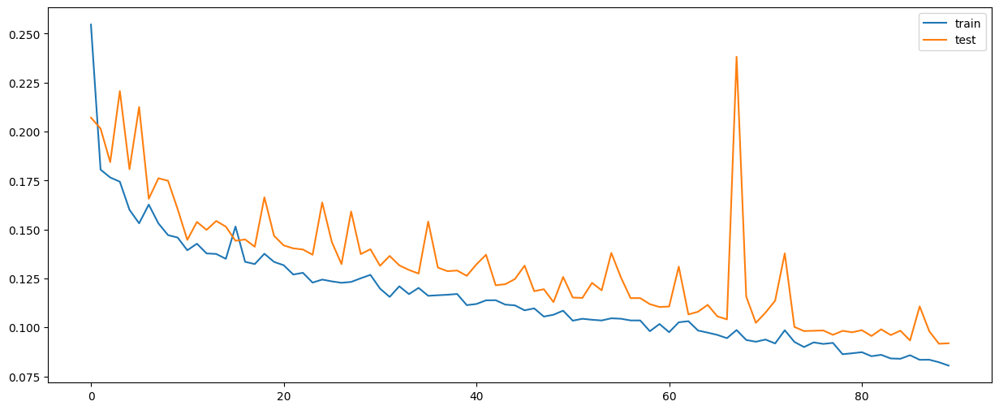

In [32]:
plt.figure(figsize=(15,6))
plt.plot(losses, label="train")
plt.plot(tlosses, label="test")
plt.legend()

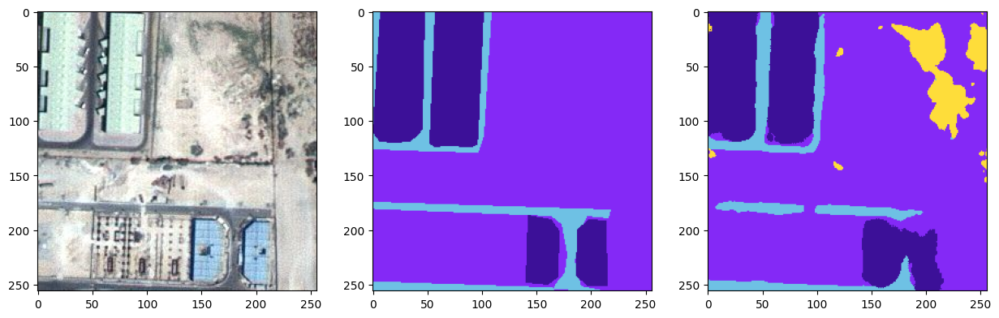

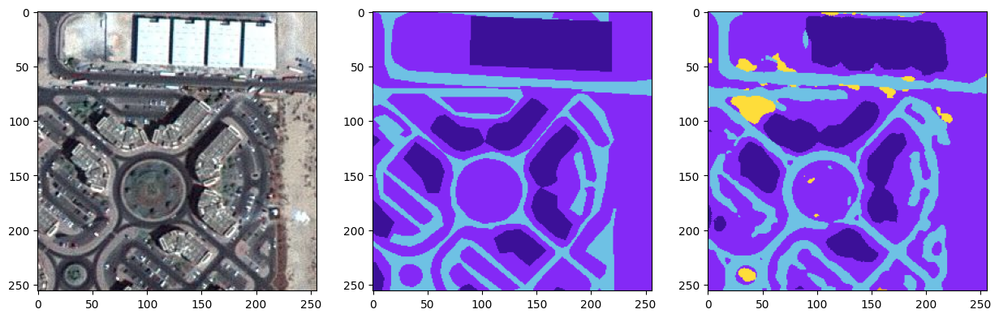

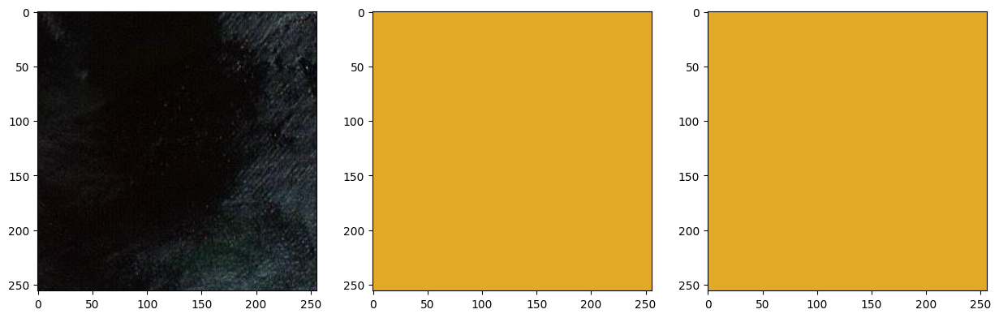

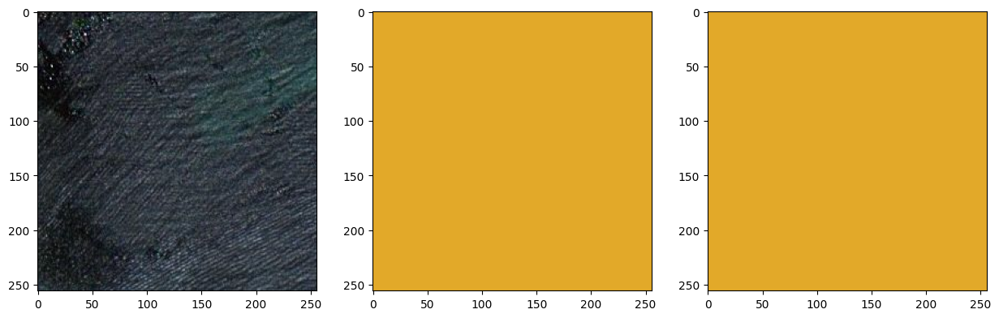

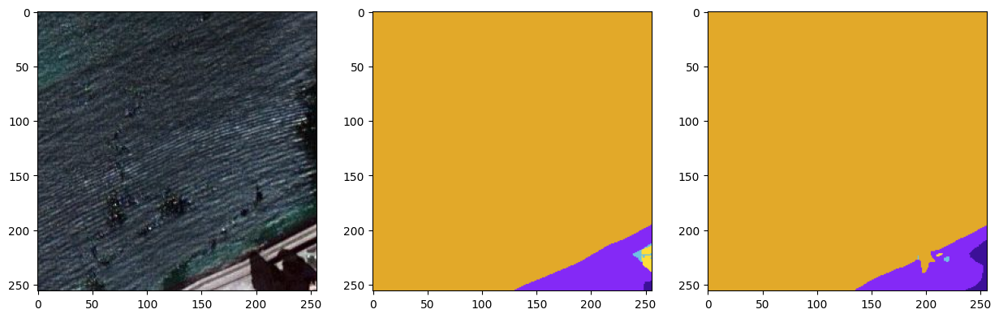

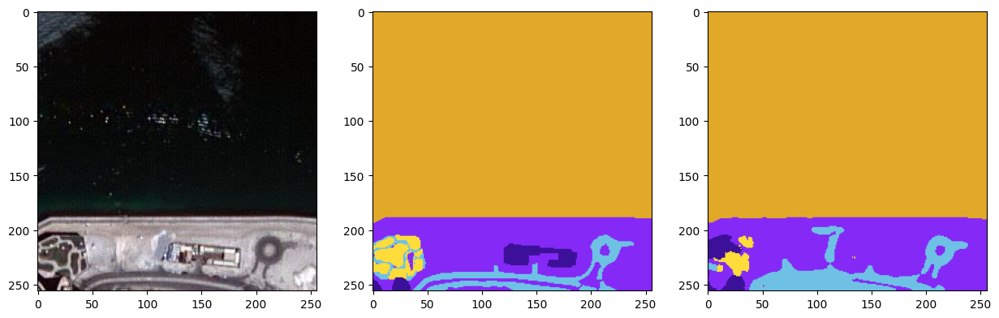

In [33]:
model.eval()
n=6
with torch.inference_mode():
    for i, img in enumerate(Test_data.np_images[:n]):
        pred=model(img.unsqueeze(dim=0).to(DEVICE))
        plt.figure(figsize=(95,40))
        plt.subplot(1,n*3,i+1 if i%2==0 else i+3)
        plt.imshow(img.cpu().permute(1,2,0)) 
        plt.subplot(1,n*3,i+2 if i%2==0 else i+4)
        plt.imshow(conv_to_RGB_lbl(Test_data.np_masks[i])) 
        plt.subplot(1,n*3,i+3 if i%2==0 else i+5)
        plt.imshow(conv_to_RGB(pred))
        if i%2==1:
            plt.show()
        

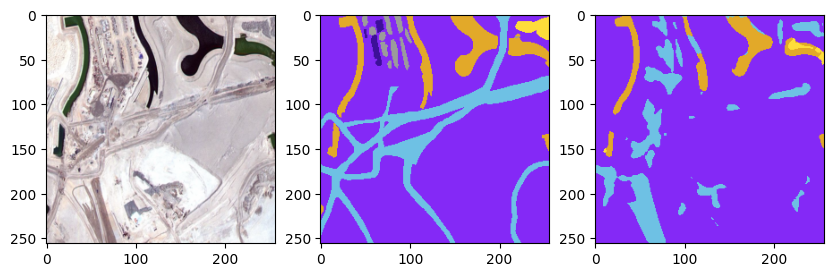

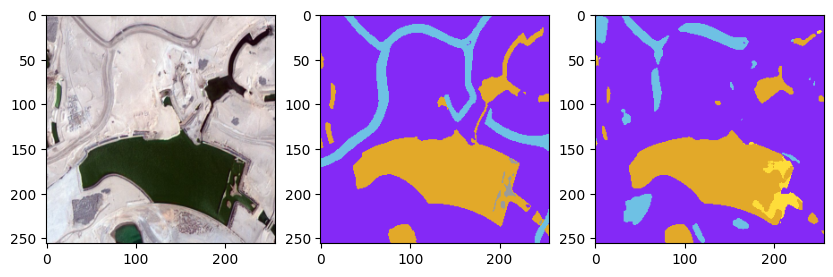

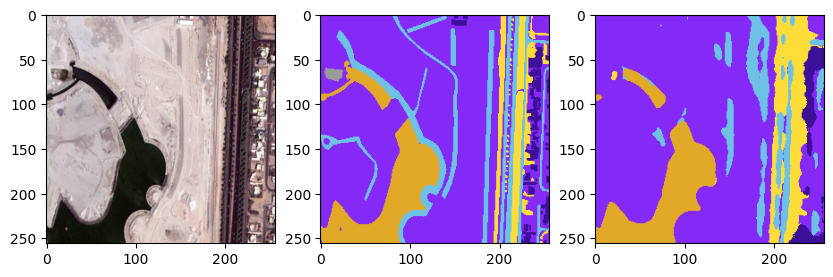

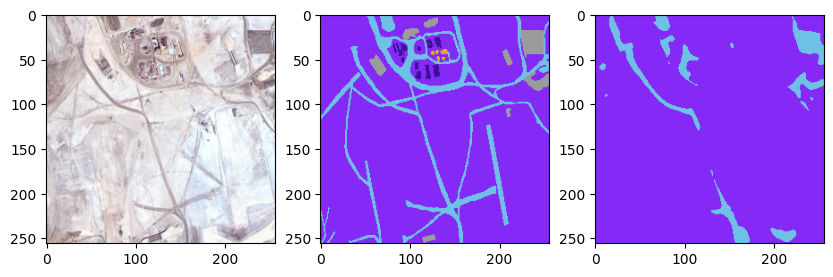

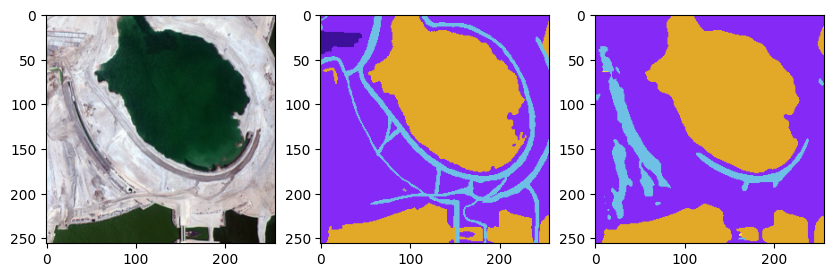

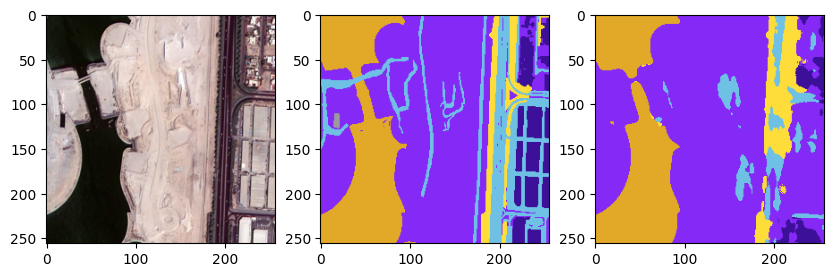

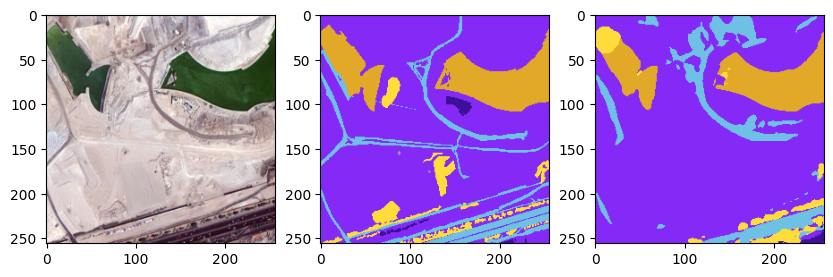

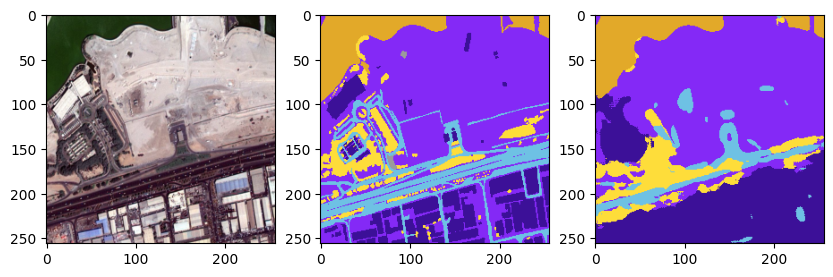

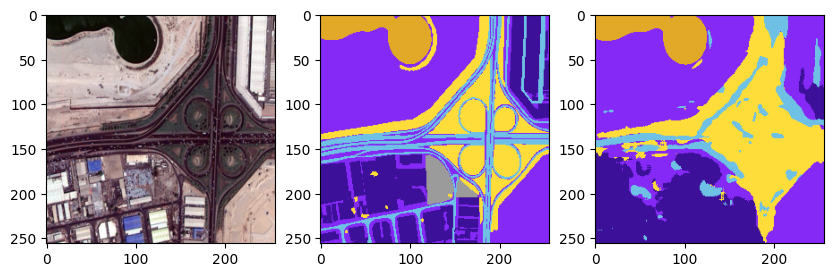

In [34]:
model.eval()
n= len(full_image_test)
with torch.inference_mode():
    for i, img in enumerate(full_image_test.np_images):
        pred=model(img.unsqueeze(dim=0).to(DEVICE))
        plt.figure(figsize=(95,40))
        plt.subplot(1,n*3,i+1 if i%2==0 else i+3)
        plt.imshow(img.cpu().permute(1,2,0)) 
        plt.subplot(1,n*3,i+2 if i%2==0 else i+4)
        plt.imshow(conv_to_RGB_lbl(full_image_test.np_masks[i])) 
        plt.subplot(1,n*3,i+3 if i%2==0 else i+5)
        plt.imshow(conv_to_RGB(pred))
        if i%2==1:
            plt.show()
        

In [35]:
model.to(DEVICE)
for i in tqdm(range(10)):
    print(f"{'#'*20} Epoch {i} {'#'*20}")
    print("Training....")
    l, iou, jaccard, le= Train_model(model, train_loader, criterion, optimizer, umetrix)
    losses.append(l); ious.append(iou); Jaccards.append(jaccard); localization_errors.append(le)
    print("Testing.......")
    lt, iout, jaccardt, let = Test_model(model, test_loader, criterion, umetrix)
    tlosses.append(lt); tiou.append(iout); tJaccard.append(jaccardt); tlocalization_error.append(let) 


  0%|          | 0/10 [00:00<?, ?it/s]

#################### Epoch 0 ####################
Training....
Train Loss: 0.0798 | Train IoU: 0.960424 | Train Jaccard: 0.763023 | Trian Localization Error: 0.502326
Testing.......


 10%|█         | 1/10 [01:28<13:12, 88.02s/it]

Test Loss: 0.0905 | Test IoU: 0.954350 | Test Jaccard: 0.739440 | Test Localization Error: 1.443872
#################### Epoch 1 ####################
Training....
Train Loss: 0.0803 | Train IoU: 0.958922 | Train Jaccard: 0.771549 | Trian Localization Error: 0.598158
Testing.......


 20%|██        | 2/10 [02:55<11:42, 87.81s/it]

Test Loss: 0.0876 | Test IoU: 0.958164 | Test Jaccard: 0.801962 | Test Localization Error: 1.544683
#################### Epoch 2 ####################
Training....
Train Loss: 0.0770 | Train IoU: 0.962829 | Train Jaccard: 0.752766 | Trian Localization Error: 0.338083
Testing.......


 30%|███       | 3/10 [04:19<10:03, 86.17s/it]

Test Loss: 0.0865 | Test IoU: 0.957249 | Test Jaccard: 0.857051 | Test Localization Error: 1.688439
#################### Epoch 3 ####################
Training....
Train Loss: 0.0755 | Train IoU: 0.963170 | Train Jaccard: 0.681679 | Trian Localization Error: 0.518038
Testing.......


 40%|████      | 4/10 [05:44<08:32, 85.45s/it]

Test Loss: 0.0819 | Test IoU: 0.955118 | Test Jaccard: 0.751282 | Test Localization Error: 2.952065
#################### Epoch 4 ####################
Training....
Train Loss: 0.0768 | Train IoU: 0.961921 | Train Jaccard: 0.710643 | Trian Localization Error: 0.489001
Testing.......


 50%|█████     | 5/10 [07:08<07:05, 85.11s/it]

Test Loss: 0.0905 | Test IoU: 0.949377 | Test Jaccard: 0.785577 | Test Localization Error: 2.647074
#################### Epoch 5 ####################
Training....
Train Loss: 0.0758 | Train IoU: 0.964205 | Train Jaccard: 0.740512 | Trian Localization Error: 0.298191
Testing.......


 60%|██████    | 6/10 [08:35<05:43, 85.83s/it]

Test Loss: 0.1124 | Test IoU: 0.954949 | Test Jaccard: 0.879533 | Test Localization Error: 1.120368
#################### Epoch 6 ####################
Training....
Train Loss: 0.0767 | Train IoU: 0.964476 | Train Jaccard: 0.831419 | Trian Localization Error: 0.375633
Testing.......


 70%|███████   | 7/10 [10:03<04:18, 86.25s/it]

Test Loss: 0.0819 | Test IoU: 0.958368 | Test Jaccard: 0.839497 | Test Localization Error: 2.514460
#################### Epoch 7 ####################
Training....
Train Loss: 0.0749 | Train IoU: 0.964171 | Train Jaccard: 0.793344 | Trian Localization Error: 0.403743
Testing.......


 80%|████████  | 8/10 [11:29<02:52, 86.41s/it]

Test Loss: 0.0881 | Test IoU: 0.959638 | Test Jaccard: 0.802001 | Test Localization Error: 1.401438
#################### Epoch 8 ####################
Training....
Train Loss: 0.0793 | Train IoU: 0.962949 | Train Jaccard: 0.727141 | Trian Localization Error: 0.437882
Testing.......


 90%|█████████ | 9/10 [12:57<01:26, 86.79s/it]

Test Loss: 0.1017 | Test IoU: 0.954899 | Test Jaccard: 0.839103 | Test Localization Error: 2.618099
#################### Epoch 9 ####################
Training....
Train Loss: 0.0731 | Train IoU: 0.964790 | Train Jaccard: 0.811479 | Trian Localization Error: 0.387866
Testing.......


100%|██████████| 10/10 [14:21<00:00, 86.14s/it]

Test Loss: 0.0854 | Test IoU: 0.958795 | Test Jaccard: 0.786658 | Test Localization Error: 1.760284


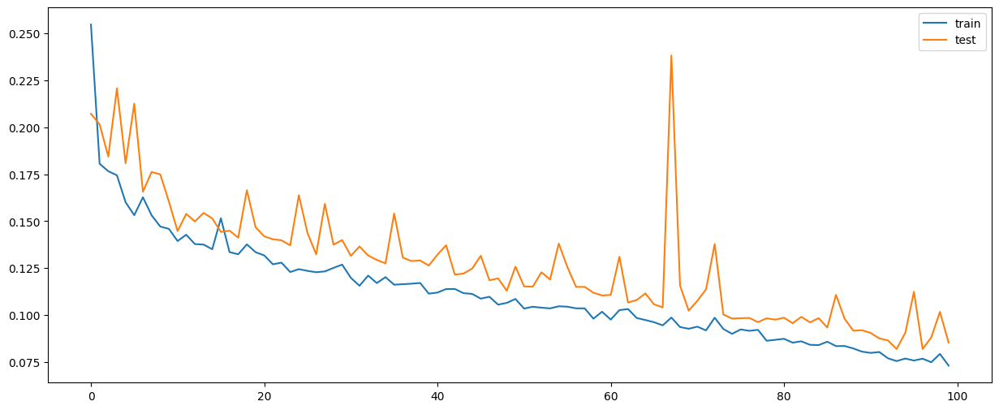

In [36]:
plt.figure(figsize=(15,6))
plt.plot(losses, label="train")
plt.plot(tlosses, label="test")
plt.legend()

25


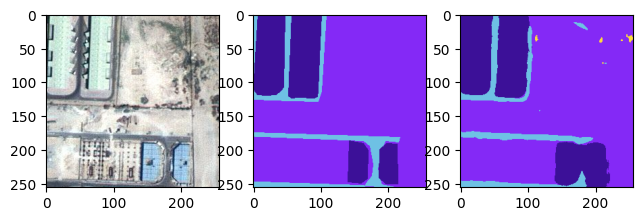

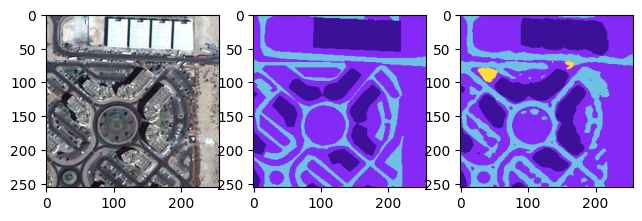

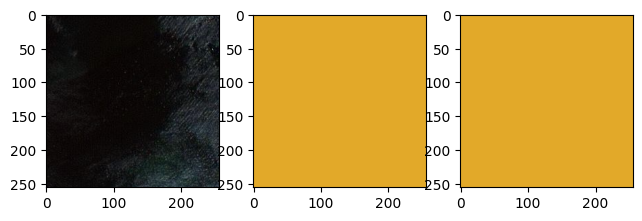

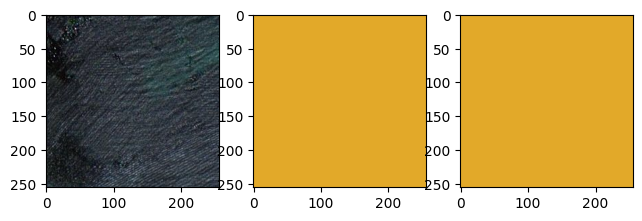

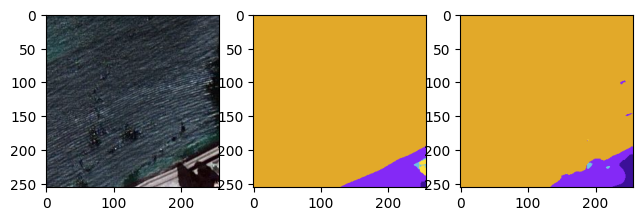

...

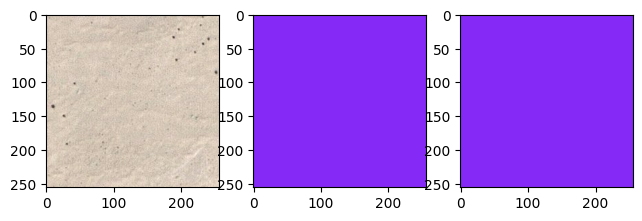

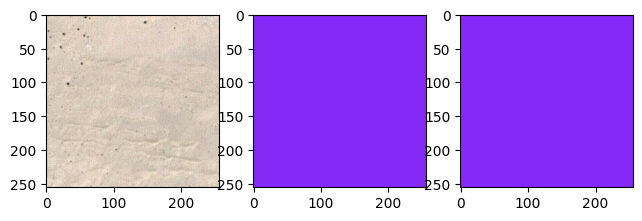

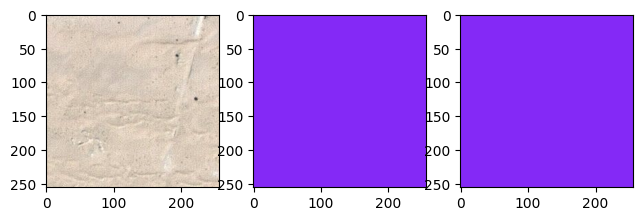

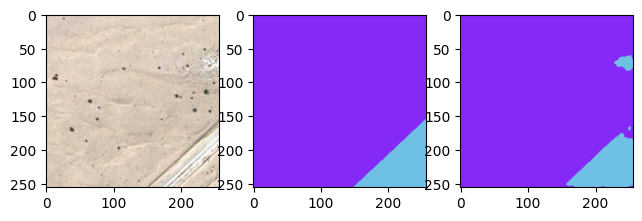

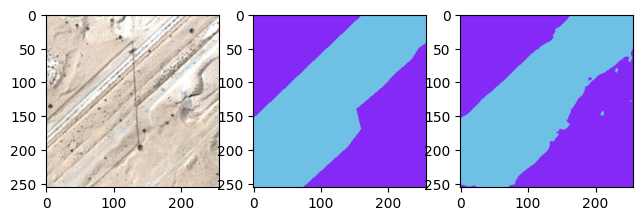

In [47]:
model.eval()
n= len(Test_data.np_images)//8
print(n)
with torch.inference_mode():
    for i, img in enumerate(Test_data.np_images[:n]):
        pred=model(img.unsqueeze(dim=0).to(DEVICE))
        plt.figure(figsize=(200,40))
        plt.subplot(1,n*3,i+1 if i%2==0 else i+3)
        plt.imshow(img.cpu().permute(1,2,0)) 
        plt.subplot(1,n*3,i+2 if i%2==0 else i+4)
        plt.imshow(conv_to_RGB_lbl(Test_data.np_masks[i])) 
        plt.subplot(1,n*3,i+3 if i%2==0 else i+5)
        plt.imshow(conv_to_RGB(pred))
        if i%2==1:
            plt.show()
        

25


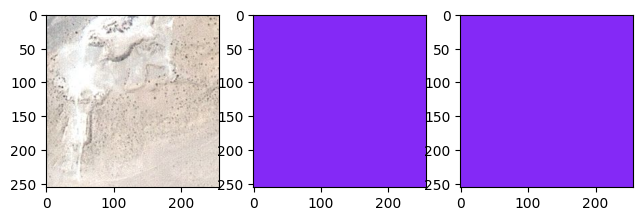

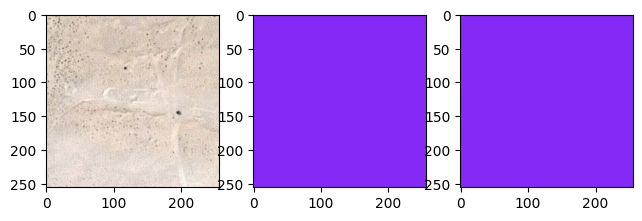

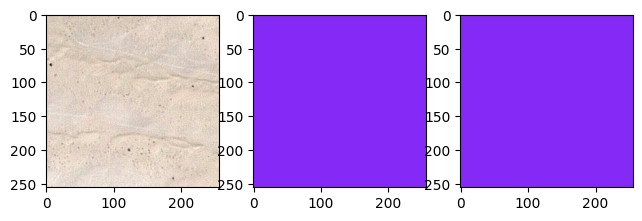

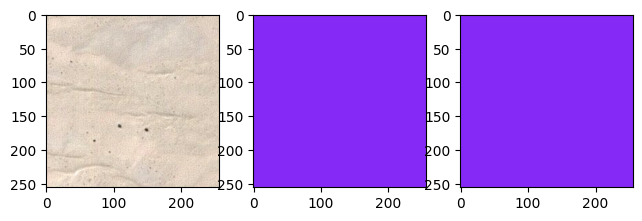

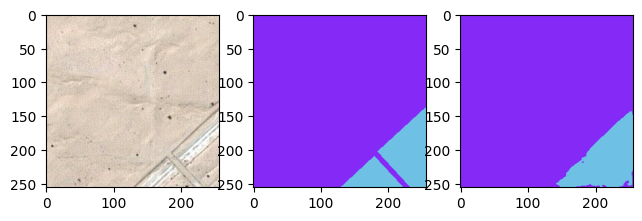

...

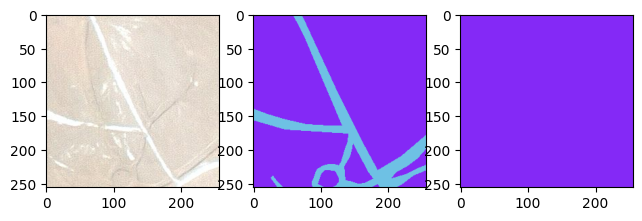

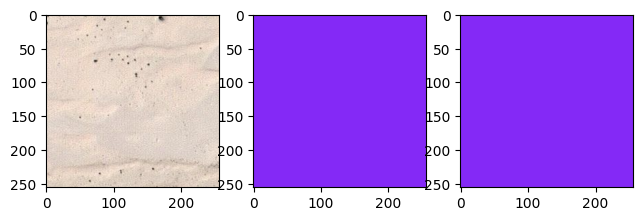

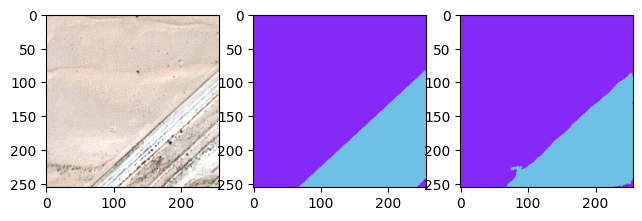

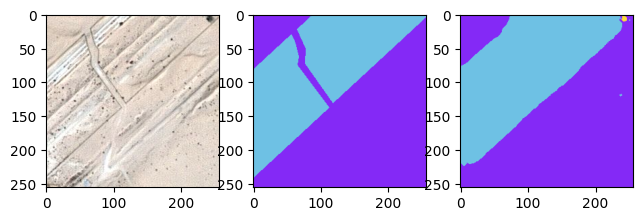

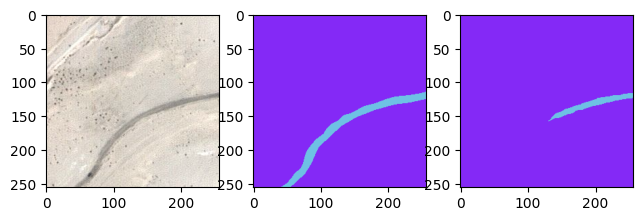

In [52]:
model.eval()
n= len(Test_data.np_images)//8
print(n)
with torch.inference_mode():
    for i, img in enumerate(Test_data.np_images[n:n*2],n):
        pred=model(img.unsqueeze(dim=0).to(DEVICE))
        plt.figure(figsize=(200,40))
        plt.subplot(1,n*3,i+1 if i%2==0 else i+3)
        plt.imshow(img.cpu().permute(1,2,0)) 
        plt.subplot(1,n*3,i+2 if i%2==0 else i+4)
        plt.imshow(conv_to_RGB_lbl(Test_data.np_masks[i])) 
        plt.subplot(1,n*3,i+3 if i%2==0 else i+5)
        plt.imshow(conv_to_RGB(pred))
        if i%2==1:
            plt.show()
        

25


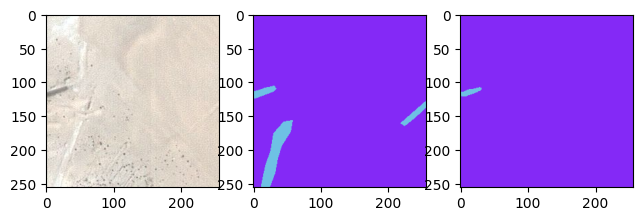

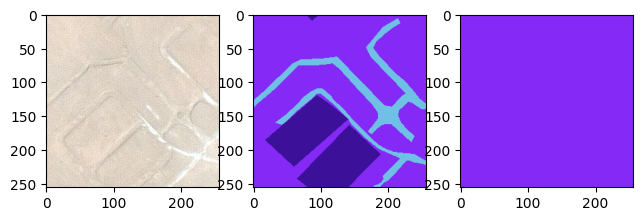

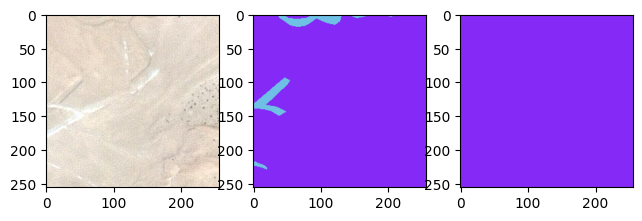

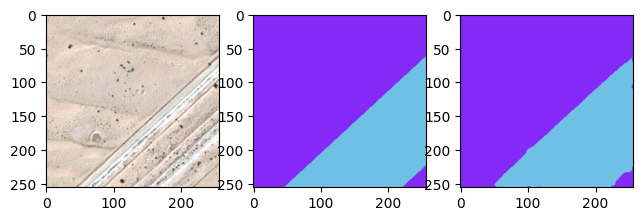

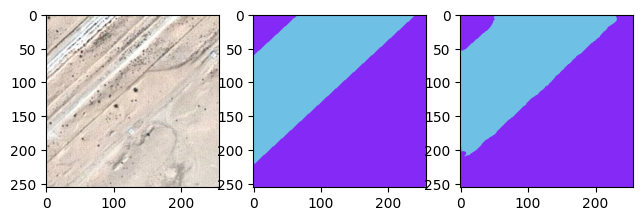

...

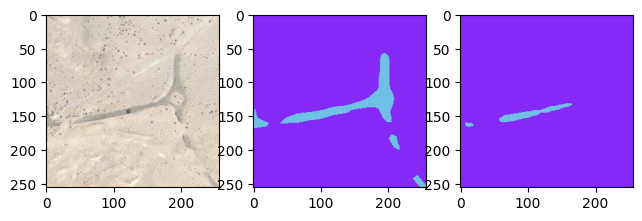

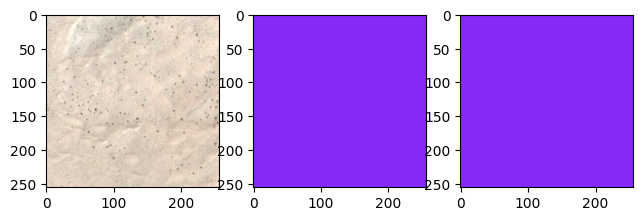

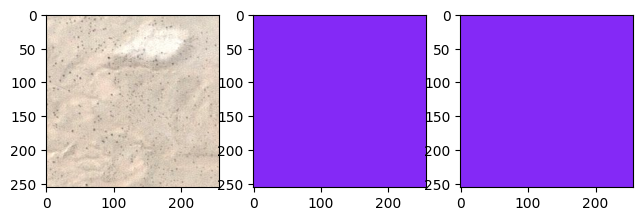

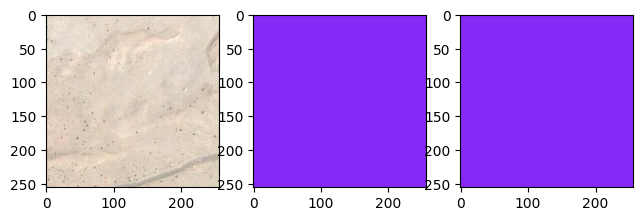

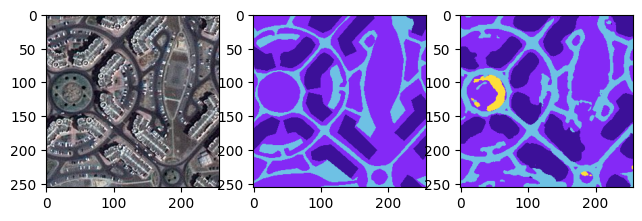

In [58]:
model.eval()
n= len(Test_data.np_images)//8
print(n)
with torch.inference_mode():
    for i, img in enumerate(Test_data.np_images[n*2:n*3],n*2):
        pred=model(img.unsqueeze(dim=0).to(DEVICE))
        plt.figure(figsize=(200,40))
        plt.subplot(1,n*3,i//2+1 if i%2==0 else i//2+3)
        plt.imshow(img.cpu().permute(1,2,0)) 
        plt.subplot(1,n*3,i//2+2 if i%2==0 else i//2+4)
        plt.imshow(conv_to_RGB_lbl(Test_data.np_masks[i])) 
        plt.subplot(1,n*3,i//2+3 if i%2==0 else i//2+5)
        plt.imshow(conv_to_RGB(pred))
        if i%2==1:
            plt.show()
        

25


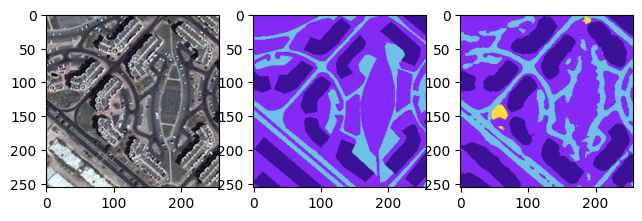

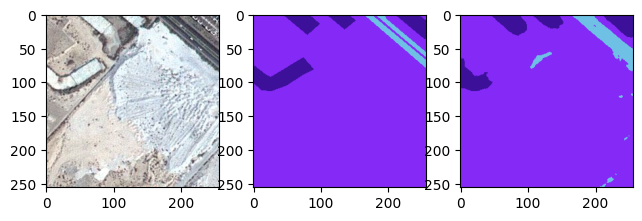

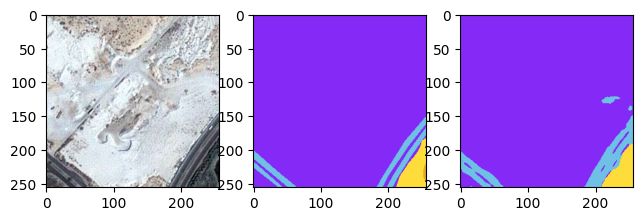

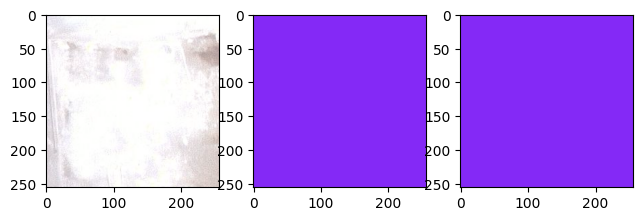

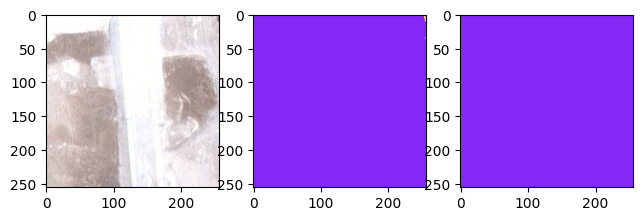

...

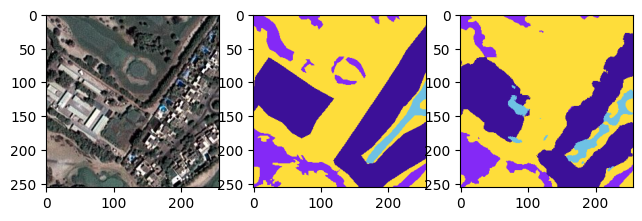

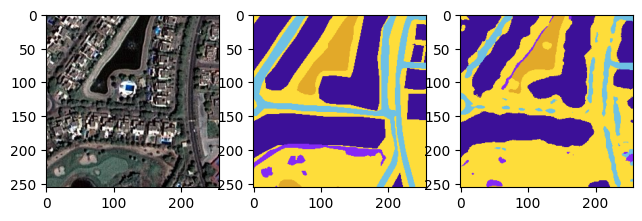

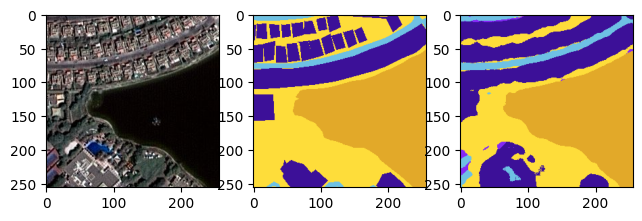

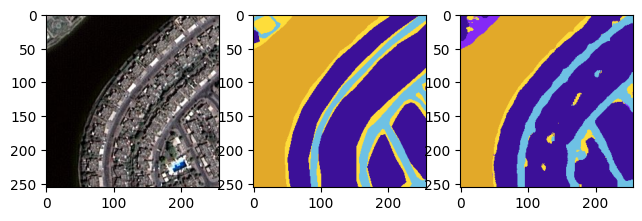

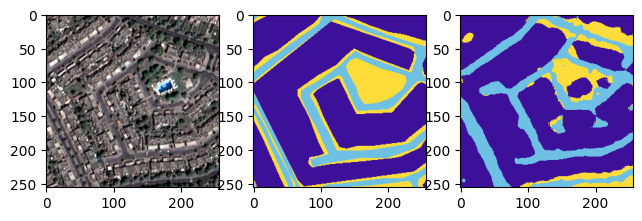

In [57]:
model.eval()
n= len(Test_data.np_images)//8
print(n)
with torch.inference_mode():
    for i, img in enumerate(Test_data.np_images[n*3:n*4],n*3):
        pred=model(img.unsqueeze(dim=0).to(DEVICE))
        plt.figure(figsize=(200,40))
        plt.subplot(1,n*3,i//3+1 if i%2==0 else i//3+3)
        plt.imshow(img.cpu().permute(1,2,0)) 
        plt.subplot(1,n*3,i//3+2 if i%2==0 else i//3+4)
        plt.imshow(conv_to_RGB_lbl(Test_data.np_masks[i])) 
        plt.subplot(1,n*3,i//3+3 if i%2==0 else i//3+5)
        plt.imshow(conv_to_RGB(pred))
        if i%2==1:
            plt.show()
        

25


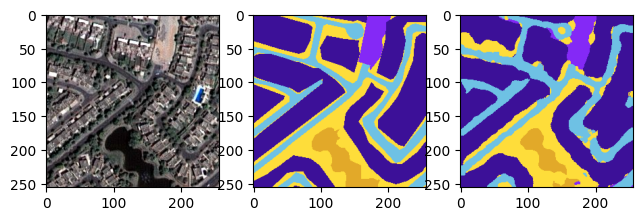

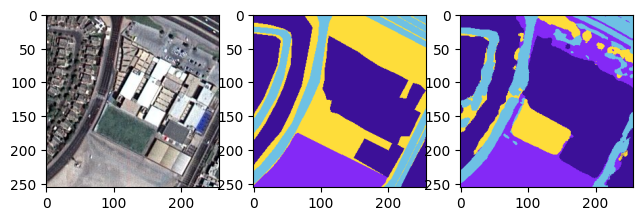

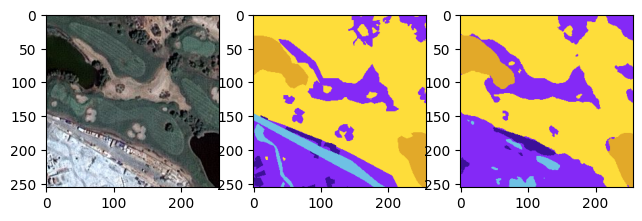

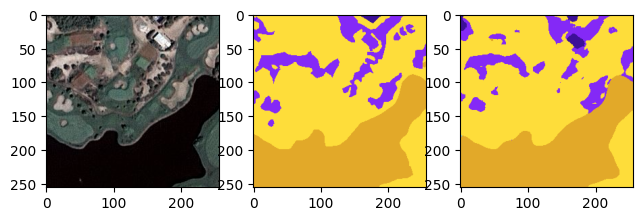

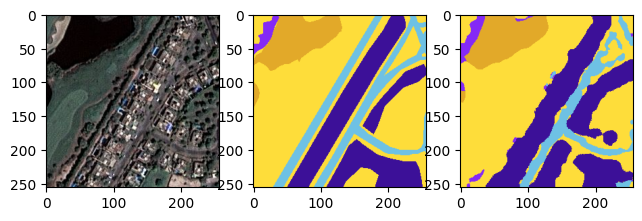

...

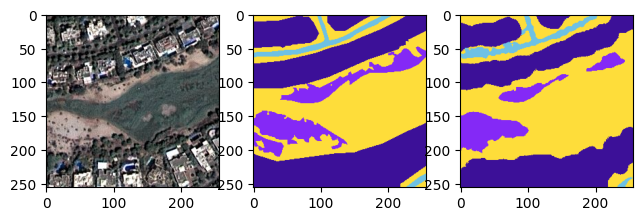

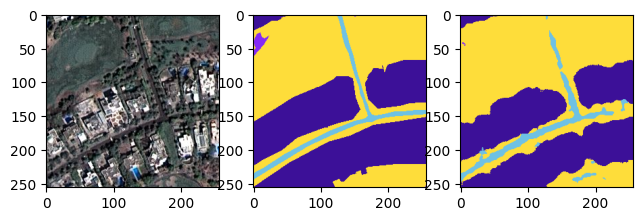

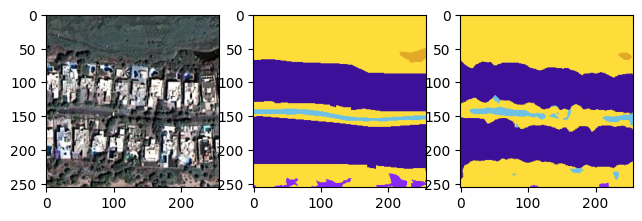

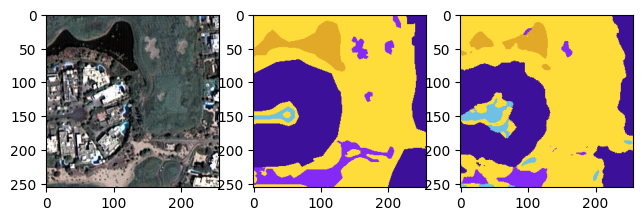

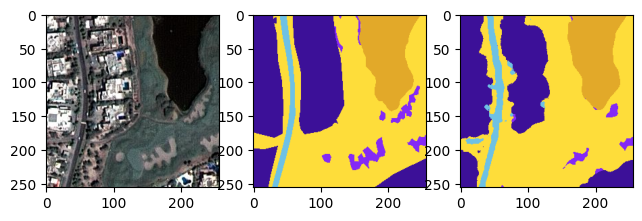

In [60]:
model.eval()
n= len(Test_data.np_images)//8
print(n)
with torch.inference_mode():
    for i, img in enumerate(Test_data.np_images[n*4:n*5],n*4):
        pred=model(img.unsqueeze(dim=0).to(DEVICE))
        plt.figure(figsize=(200,40))
        plt.subplot(1,n*3,i//4+1 if i%2==0 else i//4+3)
        plt.imshow(img.cpu().permute(1,2,0)) 
        plt.subplot(1,n*3,i//4+2 if i%2==0 else i//4+4)
        plt.imshow(conv_to_RGB_lbl(Test_data.np_masks[i])) 
        plt.subplot(1,n*3,i//4+3 if i%2==0 else i//4+5)
        plt.imshow(conv_to_RGB(pred))
        if i%2==1:
            plt.show()
        

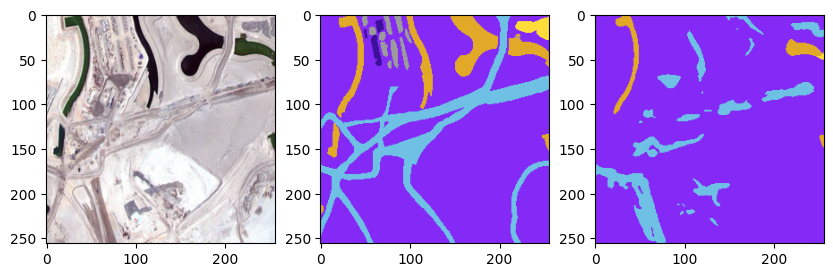

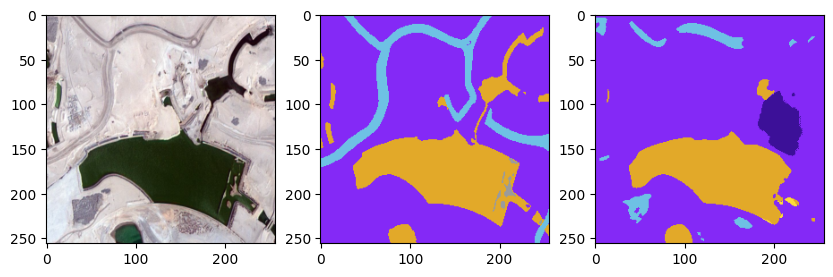

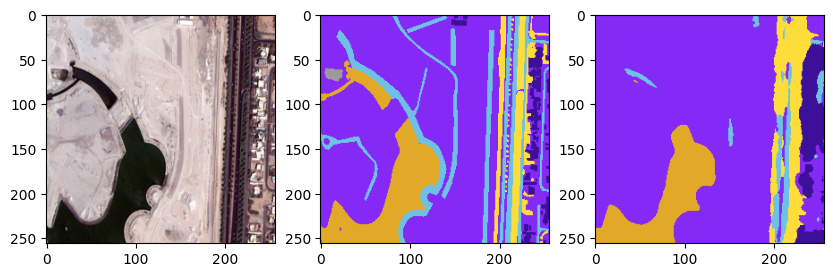

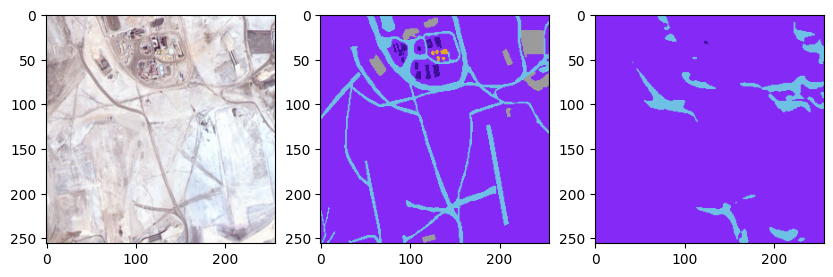

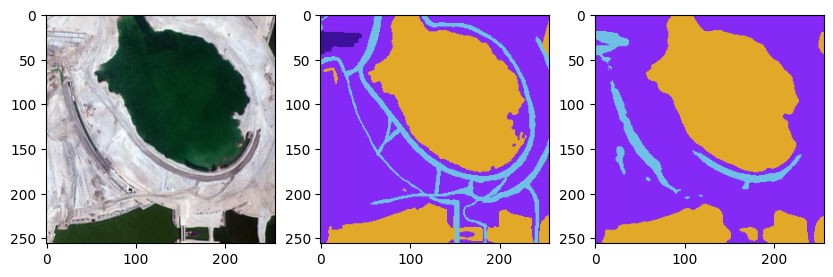

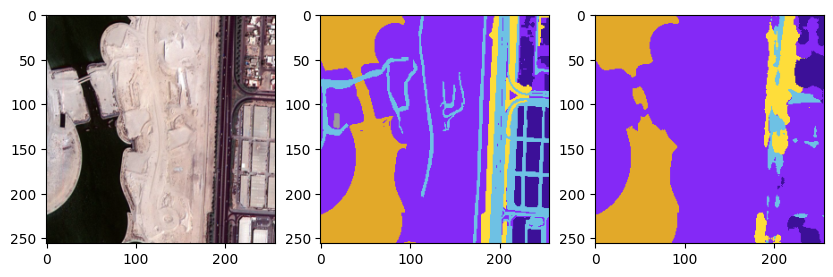

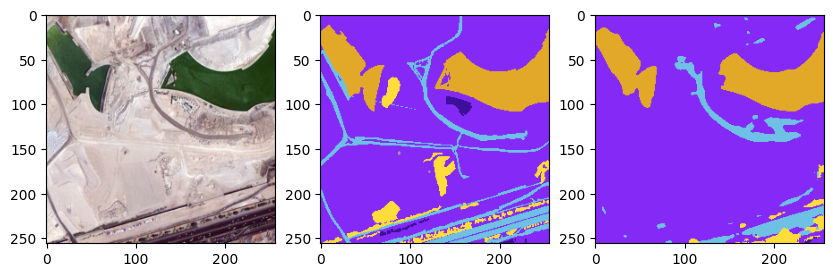

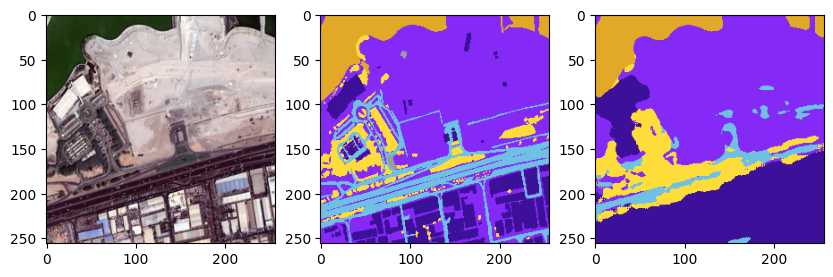

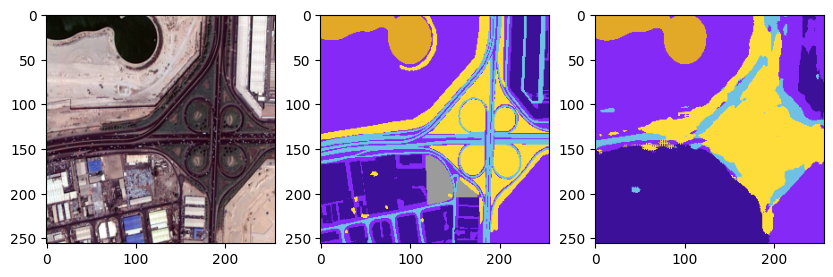

In [40]:
model.eval()
n= len(full_image_test)
with torch.inference_mode():
    for i, img in enumerate(full_image_test.np_images):
        pred=model(img.unsqueeze(dim=0).to(DEVICE))
        plt.figure(figsize=(95,40))
        plt.subplot(1,n*3,i+1 if i%2==0 else i+3)
        plt.imshow(img.cpu().permute(1,2,0)) 
        plt.subplot(1,n*3,i+2 if i%2==0 else i+4)
        plt.imshow(conv_to_RGB_lbl(full_image_test.np_masks[i])) 
        plt.subplot(1,n*3,i+3 if i%2==0 else i+5)
        plt.imshow(conv_to_RGB(pred))
        if i%2==1:
            plt.show()
        

In [61]:
import os

In [73]:
os.listdir("/kaggle/working/metrics/")

['model_20_epoch_patchifyImages_0.0311_Jaccards.npy',
 'model_20_epoch_patchifyImages_0.0311_TestLocalizationErrors.npy',
 'model_101_epoch_patchifyImages_0.0633.pth',
 'model_20_epoch_patchifyImages_0.0311_TestLosses.npy',
 'model_20_epoch_patchifyImages_0.0311_TestIoUs.npy',
 'model_state_dict_101_epoch_patchifyImages_0.0633.pth',
 'model_20_epoch_patchifyImages_0.0311_localiztion_errors.npy',
 'model_20_epoch_patchifyImages_0.0311_losses.npy',
 'model_20_epoch_patchifyImages_0.0311_TestJaccards.npy',
 'model_20_epoch_patchifyImages_0.0311_ious.npy']

In [62]:
os.mkdir("metrics")

In [70]:
torch.save(model, "./metrics/model_101_epoch_patchifyImages_0.0633.pth")
torch.save(model.state_dict(), "./metrics/model_state_dict_101_epoch_patchifyImages_0.0633.pth")


In [72]:
np.save("./metrics/model_20_epoch_patchifyImages_0.0311_losses", np.array(losses))
np.save("./metrics/model_20_epoch_patchifyImages_0.0311_ious", np.array(ious))
np.save("./metrics/model_20_epoch_patchifyImages_0.0311_localiztion_errors",np.array(localization_errors))
np.save("./metrics/model_20_epoch_patchifyImages_0.0311_Jaccards",np.array(Jaccards))
np.save("./metrics/model_20_epoch_patchifyImages_0.0311_TestLosses",np.array(tlosses))
np.save("./metrics/model_20_epoch_patchifyImages_0.0311_TestIoUs",np.array(tiou))
np.save("./metrics/model_20_epoch_patchifyImages_0.0311_TestLocalizationErrors",np.array(tlocalization_error))
np.save("./metrics/model_20_epoch_patchifyImages_0.0311_TestJaccards",np.array(tJaccard))

with torch.no_grad():
    pred = model(x[0].to(DEVICE))

x[1].shape

result = umetrix.calculate(
    np.argmax(x[1].squeeze().permute(2,3,1,0).numpy(),axis=2),
    np.argmax(pred.squeeze().cpu().permute(2,3,1,0).numpy(),axis=2),
    strict=True,
    iou_threshold=0.7
)

result.results

result.results.localization_error

In [77]:
import os
import subprocess
from IPython.display import FileLink, display

def download_file(path, download_file_name):
    os.chdir('/kaggle/working/metrics/')
    zip_name = f"/kaggle/working/{download_file_name}.zip"
    command = f"zip {zip_name} {path} -r"
    result = subprocess.run(command, shell=True, capture_output=True, text=True)
    if result.returncode != 0:
        print("Unable to run zip command!")
        print(result.stderr)
        return
    display(FileLink(f'{download_file_name}.zip'))

In [78]:
download_file("/kaggle/working/","metrics")

/kaggle/working/metrics/metrics.zip